<a href="https://colab.research.google.com/github/changsin/FSDL/blob/main/aleatoric_uncertainty_experiment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dataset setup
The data came from:
https://www.kaggle.com/andrewmvd/car-plate-detection



This dataset contains 433 images with bounding box annotations of the car license plates within the image. Our goal here is to train a convolutional neural network capable of locating licenses plate on new images. 

## Requires manual interactions

### Mount the google drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Weigts and Biases

In [3]:
!pip install wandb -qqq
import wandb
wandb.login()

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

## Prepare the data

Import libraries

In [4]:
%matplotlib inline

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import cv2
import os
import glob

IMAGE_SIZE = 224
DATA_ROOT = "./drive/MyDrive/data/Kaggle_license_plates"

# import os
# for dirname, _, filenames in os.walk(DATA_ROOT):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

We create the variable X containing all the images of cars by resizing them.



In [5]:
img_dir = DATA_ROOT + "/images" # Enter Directory of all images 
data_path = os.path.join(img_dir,'*g')
files = glob.glob(data_path)
files.sort() #We sort the images in alphabetical order to match them to the xml files containing the annotations of the bounding boxes
X_raw=[]
for f1 in files:
    img = cv2.imread(f1)
    img = cv2.resize(img, (IMAGE_SIZE,IMAGE_SIZE))
    X_raw.append(np.array(img))
    

We create the variable y containing all the bounding boxe annotations (label). 
Before that, we will have to resize the annotations so that it fits the new size of the images (200*200). We create a function resizeannotation for that. 

In [6]:
from lxml import etree
def resizeannotation(f):
    tree = etree.parse(f)
    for dim in tree.xpath("size"):
        width = int(dim.xpath("width")[0].text)
        height = int(dim.xpath("height")[0].text)
    for dim in tree.xpath("object/bndbox"):
        xmin = int(dim.xpath("xmin")[0].text)/(width/IMAGE_SIZE)
        ymin = int(dim.xpath("ymin")[0].text)/(height/IMAGE_SIZE)
        xmax = int(dim.xpath("xmax")[0].text)/(width/IMAGE_SIZE)
        ymax = int(dim.xpath("ymax")[0].text)/(height/IMAGE_SIZE)
    return [int(xmin), int(ymin), int(xmax), int(ymax)]
        

In [7]:
label_dir = DATA_ROOT + "/annotations"
text_files = [DATA_ROOT + '/annotations/'+f for f in sorted(os.listdir(label_dir))]

y_raw=[]
for f in text_files:
    # print(f)
    y_raw.append(resizeannotation(f))

### Change annotations to YOLO v5 format
YOLO v5 format is:

class-id x-center y-center width height

https://github.com/ultralytics/yolov5/issues/12

In [8]:
# change to yolo v5 format
# https://github.com/ultralytics/yolov5/issues/12
# [x_top_left, y_top_left, x_bottom_right, y_bottom_right] to
# [x_center, y_center, width, height]
def to_yolov5(y):
  width = y[2] - y[0]
  height = y[3] - y[1]

  if width < 0 or height < 0:
    print("ERROR: negative width or height ", width, height, y)
    raise AssertionError("Negative width or height")
  return int(y[0] + (width/2)), int(y[1] + (height/2)), width, height

y_yolov5 = np.array([to_yolov5(y) for y in y_raw])
y_yolov5[0]

array([144, 124,  86,  40])

In [9]:
# NB: the values are scaled down to 0..1
def to_rect(y):
  width = np.clip(y[2], 0, IMAGE_SIZE)
  height = np.clip(y[3], 0, IMAGE_SIZE)

  if width < 0 or height < 0:
    print("ERROR: negative width or height ", width, height, y)
    raise AssertionError("Negative width or height")

  return int(y[0] - width/2), int(y[1] - height/2), int(y[0] + width/2), int(y[1] + height/2)

In [10]:
def print_file(text_file):
  with open(text_file, "r") as file:
    for line in file:
      print(line)

We check X and y shape

In [11]:
print(np.array(X_raw).shape)
print(np.array(y_raw).shape)

(433, 224, 224, 3)
(433, 4)


A method to introduce noise to annotations.

In [12]:
def noise_annotation(y, min, max):
  y_noise = []
  for y1 in y:
    x_center = np.random.uniform(min, max, 1)
    y_center = np.random.uniform(min, max, 1)
    width = np.random.uniform(0, x_center, 1)
    height = np.random.uniform(0, y_center, 1)

    y_noise.append([x_center, y_center, width, height])
    # y1_noise = []
    # for e in y1:
    #   # num = int(np.random.normal(loc=e, scale=scale, size=1))
    #   num = int(np.random.noncentral_chisquare(loc=e, scale=scale, size=1))
    #   y1_noise.append(np.clip(num, 0, IMAGE_SIZE))
    # noise = np.random.noncentral_chisquare(100, 4, 4), 0, 100)
  return np.array(y_noise).reshape((-1))

# print("original: ", y_raw[0])
# y_noise = noise_annotation(y_raw, 5)
# print("with noise: ", y_noise[0])

And we display the first eighteen image of the dataset : 

In [13]:
import matplotlib.patches as patches

def create_patch_rectangle(y, color):
  # width = y[2] - y[0]
  # height = y[3] - y[1]
  # return patches.Rectangle((y[0], y[1]),
  #                           width, height,
  #                           edgecolor=color, fill=False)
  # # in yolov5
  width = int(y[2])
  height = int(y[3])
  return patches.Rectangle((int(y[0] - width/2), int(y[1] - height/2)),
                           width, height,
                           edgecolor=color, fill=False)

### Transform & normalize data
We split our dataset in two : training set/testing set

In [14]:
# from sklearn.model_selection import train_test_split

#Transforming in array
X = np.array(X_raw)
y = np.array(y_yolov5)

#Renormalisation
X = X / IMAGE_SIZE
y = y / IMAGE_SIZE

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=1)

In [15]:
def check_negative(y):
  for y1 in y:
    if y1[0] < 0.0 or y1[1] < 0.0 or y1[2] < 0.0 or y1[3] < 0.0:
      print("ERROR: negative number", y1)
      raise AssertionError("Negative number")
check_negative(y)

In [145]:
def plot_images(X, y, ids):
  fig = plt.figure(figsize=(20,40))
  i = 0
  for id in ids:
    if i > 49:
      break

    axis = fig.add_subplot(10, 5, i+1)
    i += 1
    plt.axis('off')
    image = X[id]

    rect_ori = create_patch_rectangle(y[id]*IMAGE_SIZE, (0, 255/255, 0))
    axis.add_patch(rect_ori)
    plt.imshow(np.clip(image, 0, 1))

## Clustering

### Run K Means clustering on data

The Elbow method found 11 to be optimal clusters, but given the small number of data, we can choose a smaller number of clusters for the experiments.

Ideally, we want to:

1. Ensure that we have the same distributions for train, validation and test datasets.
2. Pick uniformally across various dataset clusters.
3. Observe any discrepancies across clusters.
4. Find the minimum set of training sets for optimal performance.


In [17]:
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.applications.vgg16 import VGG16
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn import preprocessing  # to normalise existing X

import numpy as np
import tensorflow as tf
import tensorflow_probability as tfp
dist = tfp.distributions

# from keras.preprocessing import image
# from keras.applications.vgg16 import preprocess_input, decode_predictions

#Calculate similar matrics
def cosine_similarity(ratings):
    sim = ratings.dot(ratings.T)
    if not isinstance(sim,np.ndarray):
        sim = sim.toarray()
    norms = np.array([np.sqrt(np.diagonal(sim))])
    return (sim/norms/norms.T)

def get_feature_maps(input):
    # #Convert to VGG input format
    # NB: This messes up the existing data so skipping it
    #   similarity measures do not seem to be affected by this.
    # vgg_input = preprocess_input(input)

    #include_top=False == not getting VGG16 last 3 layers
    model = VGG16(weights = "imagenet", include_top=False)

    #Get features
    # feature_maps = model.predict(vgg_input)
    feature_maps = model.predict(input)

    return feature_maps, model

    # #Calculate similar metrics
    # features_compress = features.reshape(len(y_test), 7*7*512)
    # sim = cosine_similarity(features_compress)

# model_vgg16, feature_maps = get_feature_maps(X)

### Cluster the whole dataset then partition
The optimal number of clusters depends on the dataset. For the kaggle dataset, five seems to be a good number as this will give us a balanced distribution for all clusters.

(array([155.,  74.,  58.,  81.,  65.]),
 array([0, 1, 2, 3, 4, 5]),
 <a list of 1 Patch objects>)

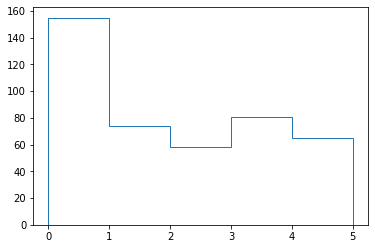

In [435]:
# 5 clusters seems to work well for this dataset
K = 5

fm_x, _ = get_feature_maps(X)
# use cosine distance to find similarities
fm_x_normalized = preprocessing.normalize(fm_x.reshape(len(fm_x), -1))

clusters_x = KMeans(n_clusters=K, random_state=0).fit(fm_x_normalized)
histo_x, bins = np.histogram(clusters_x.labels_, bins=range(K + 1))

plt.hist(bins[:-1], bins, weights=histo_x, histtype='step', label='x')

<BarContainer object of 5 artists>

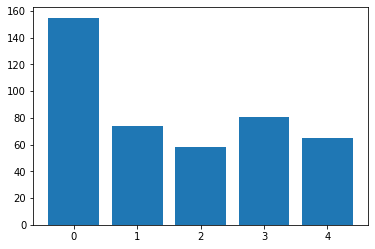

In [436]:
plt.bar(bins[:-1], histo_x, align='center')

In [438]:
bins, cluster_x_counts = np.unique(clusters_x.labels_, return_counts=True)

def to_clusters_dict(bins, data):
  cluster_dict = dict()
  for cluster_id in bins:
    cluster_dict[cluster_id] = np.where(data == cluster_id)[0]
  return cluster_dict

clusters_dict = to_clusters_dict(range(K), clusters_x.labels_)

### Partition train, validation and test sets

In [20]:
from sklearn.model_selection import train_test_split

def partition_on_clusters(X, y, bins, clusters_dict, test_size=0.2, val_size=0.1):
  X_train_d = dict()
  y_train_d = dict()
  X_val_d = dict()
  y_val_d = dict()
  X_test_d = dict()
  y_test_d = dict()

  # for each cluster reserve test_size portion for test data
  for cluster_id in bins:
    clusters_ids = clusters_dict[cluster_id]
    Xt = X[clusters_ids]
    yt = y[clusters_ids]

    Xt_train, Xt_test, yt_train, yt_test = train_test_split(Xt, yt, test_size=0.2, shuffle=False)
    Xt_train, Xt_val, yt_train, yt_val = train_test_split(Xt_train, yt_train, test_size=0.1, shuffle=False)

    X_train_d[cluster_id] = Xt_train
    y_train_d[cluster_id] = yt_train

    X_val_d[cluster_id] = Xt_val
    y_val_d[cluster_id] = yt_val

    X_test_d[cluster_id] = Xt_test
    y_test_d[cluster_id] = yt_test

  return X_train_d, y_train_d, \
         X_val_d, y_val_d, \
         X_test_d, y_test_d

X_train_d, y_train_d, X_val_d, y_val_d, X_test_d, y_test_d = \
          partition_on_clusters(X, y, bins, clusters_dict)


In [21]:
test_ids = clusters_dict[0] < len(clusters_dict[0])
test_ids

clusters_dict[0][test_ids]

array([  0,   1,  10,  13,  14,  15,  20,  24,  27,  34,  35,  41,  44,
        47,  49,  51,  52,  54,  55,  58,  61,  62,  63,  75,  76,  77,
        79,  81,  82,  83,  85,  87,  88,  89,  97, 100, 101, 104, 112,
       118, 119, 122, 123, 128, 131, 132, 135, 138, 139, 146])

In [22]:
# merge all clusters
def merge_clusters(clusters_d):
  merged = []
  for cluster_id, cluster in clusters_d.items():
    if cluster_id == 0:
      merged = cluster
    else:
      merged = np.vstack((merged, cluster))
  return merged

# merged = merge_clusters(y_train_d)

### Cluster per each partition ** DO NOT USE **
Run k means clustering on the dataset.

In [23]:
# K = 5

# fm_train, _ = get_feature_maps(X_train)
# fm_val, _ = get_feature_maps(X_val)
# fm_test, _ = get_feature_maps(X_test)

# fm_train_normalized = preprocessing.normalize(fm_train.reshape(len(fm_train), -1))
# fm_val_normalized = preprocessing.normalize(fm_val.reshape(len(fm_val), -1))
# fm_test_normalized = preprocessing.normalize(fm_test.reshape(len(fm_test), -1))

# clusters_train = KMeans(n_clusters=K, random_state=0).fit(fm_train_normalized)
# clusters_val = KMeans(n_clusters=K, random_state=0).fit(fm_val_normalized)
# clusters_test = KMeans(n_clusters=K, random_state=0).fit(fm_test_normalized)

# histo_train, bins = np.histogram(clusters_train.labels_, bins=range(K + 1))
# histo_val, _ = np.histogram(clusters_val.labels_, bins=range(K + 1))
# histo_test, _ = np.histogram(clusters_test.labels_, bins=range(K + 1))

# plt.hist(bins[:-1], bins, weights=histo_train, histtype='step', label='train')
# plt.hist(bins[:-1], bins, weights=histo_val, histtype='step', label='val')
# plt.hist(bins[:-1], bins, weights=histo_test, histtype='step', label='test')

In [24]:
# def partition_on_clusters_old(X, y, bins, clusters_dict, test_size=0.2, val_size=0.1):
#   X_train = []
#   y_train = []
#   X_val = []
#   y_val = []
#   X_test = []
#   y_test = []
  
#   # for each cluster reserve test_size portion for test data
#   for cluster_id in bins:
#     clusters_ids = clusters_dict[cluster_id]
#     Xt = X[clusters_ids]
#     yt = y[clusters_ids]

#     # Xt_train, Xt_test, yt_train, yt_test = train_test_split(Xt, yt, test_size=0.2, random_state=42)
#     # Xt_train, Xt_val, yt_train, yt_val = train_test_split(Xt_train, yt_train, test_size=0.1, random_state=0)
#     Xt_train, Xt_test, yt_train, yt_test = train_test_split(Xt, yt, test_size=0.2, shuffle=False)
#     Xt_train, Xt_val, yt_train, yt_val = train_test_split(Xt_train, yt_train, test_size=0.1, shuffle=False)

#     if cluster_id == 0:
#       X_train = Xt_train
#       y_train = yt_train

#       X_val = Xt_val
#       y_val = yt_val

#       X_test = Xt_test
#       y_test = yt_test
#     else:
#       X_train = np.vstack((X_train, Xt_train))
#       y_train = np.vstack((y_train, yt_train))

#       X_val = np.vstack((X_val, Xt_val))
#       y_val = np.vstack((y_val, yt_val))

#       X_test = np.vstack((X_test, Xt_test))
#       y_test = np.vstack((y_test, yt_test))

#     # cluster_dict_train[cluster_id] = clusters_dict[:-partition_id]
#     # cluster_dict_test[cluster_id] = clusters_dict[:-partition_id]

#     # partition_id = int(len(clusters_dict)*test_size)

#     # if cluster_id == 0:
#     #   X_train = X[clusters_dict[:-partition_id]]
#     #   y_train = y[clusters_dict[:-partition_id]]

#     #   X_test = X[clusters_dict[-partition_id:]]
#     #   y_test = y[clusters_dict[-partition_id:]]

#     # else:
#     #   X_train = np.vstack((X_train, X[clusters_dict[:-partition_id]]))
#     #   y_train = np.vstack((y_train, y[clusters_dict[:-partition_id]]))

#     #   X_test = np.vstack((X_test, X[clusters_dict[-partition_id:]]))
#     #   y_test = np.vstack((y_test, y[clusters_dict[-partition_id:]]))

#   return np.array(X_train), np.array(y_train), \
#          np.array(X_val), np.array(y_val), \
#          np.array(X_test), np.array(y_test)

# Metrics

In [25]:
#GT Boxes
gt_boxes= {"img_00285.png": [[480, 457, 515, 529], [637, 435, 676, 536]]}
#Pred Boxes
pred_boxes={"img_00285.png": {"boxes":
                             [[330, 463, 387, 505],
                              [356, 456, 391, 521],
                              [420, 433, 451, 498],
                              [468, 435, 520, 521]],
                              "scores": [0.0739, 0.0843, 0.091, 0.1008]}}

def create_gt_boxes(X_test):
  gt_boxes = dict()
  for id in range(len(X_test)):
    gt_boxes[str(id)] = [list(X_test[id].tolist())]
  return gt_boxes

def create_pred_boxes(y_preds, scores):
  pred_boxes = dict()
  for id in range(len(y_preds)):
    pred_boxes[str(id)] =  {
        "boxes": [y_preds[id].tolist()],
        "scores": list(scores[id])
    }
  return pred_boxes

In [26]:
def get_model_scores(pred_boxes):
    """Creates a dictionary of from model_scores to image ids.
    Args:
        pred_boxes (dict): dict of dicts of 'boxes' and 'scores'
    Returns:
        dict: keys are model_scores and values are image ids (usually filenames)
    """
    model_score={}
    for img_id, val in pred_boxes.items():
        for score in val['scores']:
            if score not in model_score.keys():
                model_score[score]=[img_id]
            else:
                model_score[score].append(img_id)
    return model_score

## IOU

In [27]:
# https://towardsdatascience.com/evaluating-performance-of-an-object-detection-model-137a349c517b
def calc_iou(gt_bbox, pred_bbox):
    '''
    This function takes the predicted bounding box and ground truth bounding box and 
    return the IoU ratio
    '''
    x_topleft_gt, y_topleft_gt, x_bottomright_gt, y_bottomright_gt = gt_bbox
    x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p = pred_bbox
    
    if (x_topleft_gt > x_bottomright_gt) or (y_topleft_gt > y_bottomright_gt):
      # return 0.0
        raise AssertionError("Ground Truth Bounding Box is not correct")
    if (x_topleft_p > x_bottomright_p) or (y_topleft_p > y_bottomright_p):
        raise AssertionError("Predicted Bounding Box is not correct",
                             x_topleft_p, x_bottomright_p, y_topleft_p, y_bottomright_gt)
      # return 0.0
        
         
    #if the GT bbox and predcited BBox do not overlap then iou=0
    if(x_bottomright_gt < x_topleft_p):
        # If bottom right of x-coordinate  GT  bbox is less than or above the top left of x coordinate of  the predicted BBox
      return 0.0

    if(y_bottomright_gt < y_topleft_p):  # If bottom right of y-coordinate  GT  bbox is less than or above the top left of y coordinate of  the predicted BBox
      return 0.0
    if(x_topleft_gt > x_bottomright_p): # If bottom right of x-coordinate  GT  bbox is greater than or below the bottom right  of x coordinate of  the predcited BBox
      return 0.0

    if(y_topleft_gt > y_bottomright_p): # If bottom right of y-coordinate  GT  bbox is greater than or below the bottom right  of y coordinate of  the predcited BBox
      return 0.0
    
    GT_bbox_area = (x_bottomright_gt - x_topleft_gt + 1) * (y_bottomright_gt - y_topleft_gt + 1)
    Pred_bbox_area =(x_bottomright_p - x_topleft_p + 1) * (y_bottomright_p - y_topleft_p + 1)
    
    x_top_left =np.max([x_topleft_gt, x_topleft_p])
    y_top_left = np.max([y_topleft_gt, y_topleft_p])
    x_bottom_right = np.min([x_bottomright_gt, x_bottomright_p])
    y_bottom_right = np.min([y_bottomright_gt, y_bottomright_p])
    
    intersection_area = (x_bottom_right - x_top_left + 1) * (y_bottom_right - y_top_left  + 1)
    
    union_area = (GT_bbox_area + Pred_bbox_area - intersection_area)
   
    return intersection_area/union_area

In [28]:
def calc_precision_recall(image_results):
    """Calculates precision and recall from the set of images
    Args:
        img_results (dict): dictionary formatted like:
            {
                'img_id1': {'true_pos': int, 'false_pos': int, 'false_neg': int},
                'img_id2': ...
                ...
            }
    Returns:
        tuple: of floats of (precision, recall)
    """
    true_positive=0
    false_positive=0
    false_negative=0
    for img_id, res in image_results.items():
        true_positive +=res['true_positive']
        false_positive += res['false_positive']
        false_negative += res['false_negative']
        try:
            precision = true_positive/(true_positive+ false_positive)
        except ZeroDivisionError:
            precision=0.0
        try:
            recall = true_positive/(true_positive + false_negative)
        except ZeroDivisionError:
            recall=0.0
    return (precision, recall)

In [29]:
def get_single_image_results(gt_boxes, pred_boxes, iou_thr):
    """Calculates number of true_pos, false_pos, false_neg from single batch of boxes.
    Args:
        gt_boxes (list of list of floats): list of locations of ground truth
            objects as [xmin, ymin, xmax, ymax]
        pred_boxes (dict): dict of dicts of 'boxes' (formatted like `gt_boxes`)
            and 'scores'
        iou_thr (float): value of IoU to consider as threshold for a
            true prediction.
    Returns:
        dict: true positives (int), false positives (int), false negatives (int)
    """
    all_pred_indices= range(len(pred_boxes))
    all_gt_indices=range(len(gt_boxes))
    if len(all_pred_indices)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    if len(all_gt_indices)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    
    gt_idx_thr=[]
    pred_idx_thr=[]
    ious=[]
    for ipb, pred_box in enumerate(pred_boxes):
        for igb, gt_box in enumerate(gt_boxes):
            iou= calc_iou(gt_box, pred_box)
            
            if iou >iou_thr:
                gt_idx_thr.append(igb)
                pred_idx_thr.append(ipb)
                ious.append(iou)
    iou_sort = np.argsort(ious)[::1]
    if len(iou_sort)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    else:
        gt_match_idx=[]
        pred_match_idx=[]
        for idx in iou_sort:
            gt_idx=gt_idx_thr[idx]
            pr_idx= pred_idx_thr[idx]
            # If the boxes are unmatched, add them to matches
            if(gt_idx not in gt_match_idx) and (pr_idx not in pred_match_idx):
                gt_match_idx.append(gt_idx)
                pred_match_idx.append(pr_idx)
        tp= len(gt_match_idx)
        fp= len(pred_boxes) - len(pred_match_idx)
        fn = len(gt_boxes) - len(gt_match_idx)
    return {'true_positive': tp, 'false_positive': fp, 'false_negative': fn}

In [30]:
from copy import deepcopy
def  get_avg_precision_at_iou(gt_boxes, pred_bb, iou_thr=0.5):
    model_scores = get_model_scores(pred_bb)
    sorted_model_scores= sorted(model_scores.keys())
# Sort the predicted boxes in descending order (lowest scoring boxes first):
    for img_id in pred_bb.keys():
        
        arg_sort = np.argsort(pred_bb[img_id]['scores'])
        pred_bb[img_id]['scores'] = np.array(pred_bb[img_id]['scores'])[arg_sort].tolist()
        pred_bb[img_id]['boxes'] = np.array(pred_bb[img_id]['boxes'])[arg_sort].tolist()

    pred_boxes_pruned = deepcopy(pred_bb)
    
    precisions = []
    recalls = []
    model_thrs = []
    img_results = {}
# Loop over model score thresholds and calculate precision, recall
    for ithr, model_score_thr in enumerate(sorted_model_scores[:-1]):
            # On first iteration, define img_results for the first time:
        # print("Mode score : ", model_score_thr)
        img_ids = gt_boxes.keys() if ithr == 0 else model_scores[model_score_thr]
    
        for img_id in img_ids:
            gt_boxes_img = gt_boxes[img_id]
            box_scores = pred_boxes_pruned[img_id]['scores']
            start_idx = 0
            for score in box_scores:
                if score <= model_score_thr:
                    pred_boxes_pruned[img_id]
                    start_idx += 1
                else:
                    break 
            # Remove boxes, scores of lower than threshold scores:
            pred_boxes_pruned[img_id]['scores']= pred_boxes_pruned[img_id]['scores'][start_idx:]
            pred_boxes_pruned[img_id]['boxes']= pred_boxes_pruned[img_id]['boxes'][start_idx:]
# Recalculate image results for this image
            # print(img_id)
            img_results[img_id] = get_single_image_results(gt_boxes_img,
                                      pred_boxes_pruned[img_id]['boxes'],
                                      iou_thr=0.5)
# calculate precision and recall
        prec, rec = calc_precision_recall(img_results)
        precisions.append(prec)
        recalls.append(rec)
        model_thrs.append(model_score_thr)

    precisions = np.array(precisions)
    recalls = np.array(recalls)

    prec_at_rec = []
    for recall_level in np.linspace(0.0, 1.0, 11):
        try:
            args= np.argwhere(recalls>recall_level).flatten()
            prec= max(precisions[args])
            # print(recalls,"Recall")
            # print(      recall_level,"Recall Level")
            # print(       args, "Args")
            # print(       prec, "precision")
        except ValueError:
            prec=0.0
        prec_at_rec.append(prec)
    avg_prec = np.mean(prec_at_rec) 
    return {
        'avg_prec': avg_prec,
        'precisions': precisions,
        'recalls': recalls,
        'model_thrs': model_thrs}

In [31]:
# this method is borrowed from
# https://www.pyimagesearch.com/2016/11/07/intersection-over-union-iou-for-object-detection/
def bb_iou(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    # print("xA:{} yA:{} xB:{} yB:{}".format(xA, yA, xB, yB))
    # print("xB - xA + 1:{} yB - yA + 1:{}".format(xB - xA + 1, yB - yA + 1))

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    # print("interArea:{}".format(interArea))

    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    # print("boxAArea:{} boxBArea:{}".format(boxAArea, boxBArea))

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)
    # return the intersection over union value
    return iou

# This also works, but does not quite work in some cases
# https://medium.com/koderunners/intersection-over-union-516a3950269c
def bb_iou2(box1, box2):
    x1, y1, x12, y12 = box1
    x2, y2, x22, y22 = box2
    w1 = x1 - x12
    h1 = y1 - y12
    w2 = x2 - x22
    h2 = y2 - y22
    w_intersection = min(x1 + w1, x2 + w2) - max(x1, x2)
    h_intersection = min(y1 + h1, y2 + h2) - max(y1, y2)
    if w_intersection <= 0 or h_intersection <= 0: # No overlap
        return 0
    I = w_intersection * h_intersection
    U = w1 * h1 + w2 * h2 - I # Union = Total Area - I
    return I / U

## Calculate mAP

In [477]:
# averages out sample predictions (input data)x(samples)x(prediction points = 4)
# into (input data)x(averaged prediction points = 4)
def average_sample_preds(y_sample_preds):
  averages = []
  for y_pred in y_sample_preds:
    averages.append([np.mean(y_pred[:, i]) for i in range(y_pred.shape[1])])
  return np.array(averages)

def calculate_map(y_test_scaled, y_preds_scaled, threshold=0.5):
  # y_test_scaled = y_test*IMAGE_SIZE
  # y_preds_scaled = y_preds*IMAGE_SIZE
  scores = [[calc_iou(y_test_scaled[id], y_preds_scaled[id])] for id in range(len(y_test_scaled))]

  gt_boxes = create_gt_boxes(y_test_scaled)
  preds_boxes = create_pred_boxes(y_preds_scaled, scores)

  map = get_avg_precision_at_iou(gt_boxes=gt_boxes, pred_bb=preds_boxes)
  # print("mAP:{:.2}".format(map['avg_prec']))
  return map

# Models

### Create CNN Model

In [488]:
# Create the model
def create_model():
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(Dense(128, activation="relu"))
  model.add(Dense(128, activation="relu"))
  model.add(Dense(64, activation="relu"))
  model.add(Dense(4, activation="sigmoid"))

  model.layers[-6].trainable = False
  model.summary()

  model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

  return model

### Create Probability Model

In [489]:
kl_divergence_fn = lambda q, p, _: dist.kl_divergence(q, p) / tf.cast(y_train.shape[0], dtype=tf.float32)

# Create the model
def create_prob_model():
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(Dense(128, activation="relu"))
  model.add(Dense(128, activation="relu"))
  model.add(Dense(64, activation="relu"))
  model.add(tfp.layers.DenseFlipout(4, activation="sigmoid", kernel_divergence_fn=kl_divergence_fn))

  model.layers[-6].trainable = False
  model.summary()

  model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

  return model

## Create Full Probability Model

In [490]:
kl_divergence_fn = lambda q, p, _: dist.kl_divergence(q, p) / tf.cast(y_train.shape[0], dtype=tf.float32)

# Create the model
def create_full_prob_model():
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(tfp.layers.DenseFlipout(128, activation="relu", kernel_divergence_fn=kl_divergence_fn))
  model.add(tfp.layers.DenseFlipout(128, activation="relu", kernel_divergence_fn=kl_divergence_fn))
  model.add(tfp.layers.DenseFlipout(64, activation="relu", kernel_divergence_fn=kl_divergence_fn))
  model.add(tfp.layers.DenseFlipout(4, activation="sigmoid", kernel_divergence_fn=kl_divergence_fn))

  model.layers[-6].trainable = False
  model.summary()

  model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

  return model

## Create Bayesian Model

In [491]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import tensorflow_probability as tfp
tfd = tfp.distributions


# Define the prior weight distribution as Normal of mean=0 and stddev=1.
# Note that, in this example, the we prior distribution is not trainable,
# as we fix its parameters.
def prior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    prior_model = keras.Sequential(
        [
            tfp.layers.DistributionLambda(
                lambda t: tfp.distributions.MultivariateNormalDiag(
                    loc=tf.zeros(n), scale_diag=tf.ones(n)
                )
            )
        ]
    )
    return prior_model


# Define variational posterior weight distribution as multivariate Gaussian.
# Note that the learnable parameters for this distribution are the means,
# variances, and covariances.
def posterior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    posterior_model = keras.Sequential(
        [
            tfp.layers.VariableLayer(
                tfp.layers.MultivariateNormalTriL.params_size(n), dtype=dtype
            ),
            tfp.layers.MultivariateNormalTriL(n),
        ]
    )
    return posterior_model

train_size = X_test.shape[0]

def create_bayesian():
  # Create the model
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(tfp.layers.DenseVariational(
      units=128,
      make_prior_fn=prior,
      make_posterior_fn=posterior,
      kl_weight=1/train_size,
      activation="relu"))
  model.add(tfp.layers.DenseVariational(
      units=128,
      make_prior_fn=prior,
      make_posterior_fn=posterior,
      kl_weight=1/train_size,
      activation="relu"))
  model.add(tfp.layers.DenseVariational(
      units=64,
      make_prior_fn=prior,
      make_posterior_fn=posterior,
      kl_weight=1/train_size,
      activation="relu"))
  model.add(tfp.layers.DenseVariational(
      units=4,
      make_prior_fn=prior,
      make_posterior_fn=posterior,
      kl_weight=1/train_size,
      activation="sigmoid"))

  model.layers[-6].trainable = False

  model.summary()

  model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

  return model

## Create an Aleatoric Model
Adapted from
[Uncertainty in Deep Learning. How To Measure?](https://towardsdatascience.com/my-deep-learning-model-says-sorry-i-dont-know-the-answer-that-s-absolutely-ok-50ffa562cb0b)


In [533]:
from tensorflow.keras import backend as K

# aleatoric loss function
def aleatoric_loss(y_true, y_pred):
    N = y_true.shape[0]
    se = K.pow((y_true[:,0]-y_pred[:,0]),2)
    inv_std = K.exp(-y_pred[:,1])
    mse = K.mean(inv_std*se)
    reg = K.mean(y_pred[:,1])
    return 0.5*(mse + reg)


kl_divergence_fn = lambda q, p, _: dist.kl_divergence(q, p) / tf.cast(y_train.shape[0], dtype=tf.float32)

# Create the model
def create_aleatoric_model():
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(Dense(128, activation="relu"))
  model.add(Dense(128, activation="relu"))
  model.add(Dense(64, activation="relu"))
  model.add(Dense(5, activation="sigmoid"))
  # model.add(tfp.layers.DenseFlipout(5, activation="sigmoid",
  #                                   kernel_divergence_fn=kl_divergence_fn))

  model.layers[-6].trainable = False
  model.summary()

  model.compile(optimizer='rmsprop', loss=aleatoric_loss, metrics=['mae'])

  return model

# Setup experiment

In [41]:
def scale_up(rect):
  rect = rect*IMAGE_SIZE
  return int(rect[0]), int(rect[1]), int(rect[2]), int(rect[3])

def plot_predictions(X, y_gt, y_preds):
  fig = plt.figure(figsize=(20,40))

  # The number of images for plotting is limited to 50
  end_id = len(y_gt) if len(y_gt) < 50 else 50

  y_preds_avg = average_sample_preds(y_preds)
  stds = np.std(y_preds, axis=1)
  mean_stds = np.mean(stds, axis=1)

  for i in range(0, end_id):
    axis = fig.add_subplot(10, 5, i+1)
    plt.axis('off')
    image = X[i]

    rect_ori = create_patch_rectangle(y_gt[i]*IMAGE_SIZE, (0, 255/255, 0))
    axis.add_patch(rect_ori)

    # for each test image, there could be multiple predictions
    for y_pred in y_preds[i]:
      rect_pred = create_patch_rectangle(y_pred*IMAGE_SIZE, (255/255, 0, 0))
      axis.add_patch(rect_pred)

    iou = bb_iou(to_rect(y_preds_avg[i]*IMAGE_SIZE), to_rect(y_gt[i]*IMAGE_SIZE))
    plt.title("IOU: {:0.2f} std: {:0.2f}".format(iou, mean_stds[i]))
    # plt.title("mean std: {:0.2f}".format(mean_stds[sample_ids[i]]))
    plt.imshow(np.clip(image, 0, 1))

In [42]:
# def plot_predictions_old(X_test, y_test, y_pred):
#   fig = plt.figure(figsize=(20,40))

#   end_id = len(y_test) if len(y_test) < 50 else 50
#   for i in range(0, end_id):
#     axis = fig.add_subplot(10, 5, i+1)
#     plt.subplot(10,5,i+1)
#     plt.axis('off')

#     image = X_test[i]

#     # for j in range(0, len(y_preds[i])):
#     #   # rect_pred = create_patch_rectangle(y_preds[i][j]*IMAGE_SIZE, (255/255, 0, 0))
#     #   rect_pred = create_patch_rectangle(y_preds[y_preds[i]][j]*IMAGE_SIZE, (255/255, 0, 0))
#     #   axis.add_patch(rect_pred)

#     y_pred1 = y_pred[i]*IMAGE_SIZE
#     y_pred1 = int(y_pred1[0]), int(y_pred1[1]), int(y_pred1[2]), int(y_pred1[3])

#     y_gt1 = y_test[i]*IMAGE_SIZE
#     y_gt1 = int(y_gt1[0]), int(y_gt1[1]), int(y_gt1[2]), int(y_gt1[3])

#     rect_ori = create_patch_rectangle(y_gt1, (0, 255/255, 0))
#     rect_pred = create_patch_rectangle(y_pred1, (255/255, 0, 0))
#     axis.add_patch(rect_ori)
#     axis.add_patch(rect_pred)

#     iou = bb_iou(y_pred1, y_gt1)
#     iou2 = bb_iou2(y_pred1, y_gt1)

#     plt.title("IOU: {:0.2f} IOU2:{:0.2f}".format(iou, iou2))
#     plt.imshow(image)

### Fix predictions

For really bad predictions, do some minimal fix for display and calculation purposes

In [43]:
# def fix_predictions(y_preds):
#   errors = dict()

#   for id in range(len(y_preds)):
#     for sample_id in range(len(y_preds[id])):
#       x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p = y_preds[id][sample_id]
#       if x_topleft_p > x_bottomright_p:
#         # y_preds[id][sample_id][0] = x_bottomright_p
#         # y_preds[id][sample_id][2] = x_topleft_p
#         y_preds[id][sample_id][2] = x_topleft_p + .01/IMAGE_SIZE
#         errors[id] = 1
#         # x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p = y_preds[id][sample_id]
#         # print("Fixed xbr", x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p)
#       if y_topleft_p > y_bottomright_p:
#         # y_preds[id][sample_id][1] = y_bottomright_p
#         # y_preds[id][sample_id][3] = y_topleft_p
#         y_preds[id][sample_id][3] = y_topleft_p + .01/IMAGE_SIZE
#         # errors += 1
#         errors[id] = 1
#         # x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p = y_preds[id][sample_id]
#         # print("Fixed ybr", x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p)
#   print("Fixed predictions: {}/{} {}".format(len(errors), len(y_preds), errors))
#   return y_preds

## Run experiment

In [521]:
def run_experiment(model,
                   X_train, y_train,
                   X_val, y_val,
                   X_test, y_test,
                   epochs, batch_size):
  train_history = model.fit(x=X_train, y=y_train,
                            validation_data=(X_val, y_val),
                            epochs=epochs, batch_size=batch_size, verbose=1,
                            callbacks=[wandb.keras.WandbCallback(data_type="image",
                            save_model=False)])
  # Test
  scores = model.evaluate(X_test, y_test, verbose=0)
  print("Score : %.2f%%" % (scores[1]*100))

  test_loss, test_accuracy = model.evaluate(X_test, y_test, steps=int(100))

  print("Test results \n Loss:",test_loss,'\n Accuracy',test_accuracy)

  y_preds = sample_predictions(model, X_test, iterations=1)
  # y_preds = model.predict(X_test)

  # # TODO:
  # # Hack to fix erroneous predictions
  # y_preds = fix_predictions(y_preds)
  plot_predictions(X_test, y_test, y_preds)

  averaged_predictions = average_sample_preds(y_preds)
  y_test = np.array([to_rect(y*IMAGE_SIZE) for y in y_test])
  rectified_predictions = np.array([to_rect(y*IMAGE_SIZE) for y in averaged_predictions])

  # print(rectified_predictions)
  m_ap = calculate_map(y_test*IMAGE_SIZE, rectified_predictions*IMAGE_SIZE)
  return model, y_preds, m_ap

## Sample predictions

In [45]:
def sample_predictions(model, samples, iterations=10):
    predicted = []
    for _ in range(iterations):
        predicted.append(model(samples).numpy())

    predicted = np.array(predicted)
    # predicted = np.concatenate(predicted, axis=1)

    # predicted = np.array([model_prob.predict(np.expand_dims(X_test[1], [0])) for i in range(iterations)])
    # predicted = np.concatenate(predicted, axis=1)
    reshaped = np.array([predicted[:, column] for column in range(0, predicted.shape[1])])

    return reshaped
    
def calculate_prediction_std(y_preds):
  mean = np.mean(y_preds)

  mean_stds = []
  for cluster_id in range(len(cluster_ids)):
    predicted = sample_predictions(model, X[cluster_ids[cluster_id]], iterations=50)

    stds = np.std(predicted, axis=1)
    mean_std = np.mean(stds, axis=1)
    # print(mean_std)
    print("{}: mean std: {:0.2f}".format(cluster_id, np.mean(mean_std)))
    mean_stds.append(mean_std)
  
  return mean_stds

## Run experiment on cluster

In [470]:
def run_experiment_on_cluster(model, cluster_id):
  X_ttrain = X_train[cluster_ids_train[cluster_id]]
  y_ttrain = y_train[cluster_ids_train[cluster_id]]

  X_tval = X_val[cluster_ids_val[cluster_id]]
  y_tval = y_val[cluster_ids_val[cluster_id]]

  X_ttest = X_test[cluster_ids_test[cluster_id]]
  y_ttest = y_test[cluster_ids_test[cluster_id]]

  batch_size = len(y_ttest)
  model, y_pred, map = run_experiment(model,
                                      X_ttrain, y_ttrain,
                                      X_tval, y_tval,
                                      X_ttest, y_ttest, 50, batch_size)
  
  return model, y_pred, map


# model_prob_clst = create_prob_model()
# model_clst, y_pred_clst, map_clst = run_experiment_on_cluster(model_prob_clst, 2)

## Prepare train, validation, and test data

In [47]:
X_train = merge_clusters(X_train_d)
y_train = merge_clusters(y_train_d)

X_val = merge_clusters(X_val_d)
y_val = merge_clusters(y_val_d)

X_test = merge_clusters(X_test_d)
y_test = merge_clusters(y_test_d)


# Train

## Train on clean data with regular CNN
Everything is clean. y_train and y_val are all clean labels.

wandb: Currently logged in as: changsin (use `wandb login --relogin` to force relogin)


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               3211392   
_________________________________________________________________
dense_1 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_2 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 260       
Total params: 17,951,108
Trainable params: 3,236,420
Non-trainable params: 14,714,688
____________________________________

wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 2/50
10/10 [==============================] - 1s 58ms/step - loss: 0.0336 - accuracy: 0.6991 - val_loss: 0.0268 - val_accuracy: 0.5135


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 3/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0243 - accuracy: 0.6635 - val_loss: 0.0202 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 4/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0172 - accuracy: 0.7066 - val_loss: 0.0150 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 5/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0107 - accuracy: 0.7848 - val_loss: 0.0139 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 6/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0107 - accuracy: 0.8774 - val_loss: 0.0132 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 7/50
10/10 [==============================] - 1s 58ms/step - loss: 0.0090 - accuracy: 0.8929 - val_loss: 0.0134 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 8/50
10/10 [==============================] - 1s 54ms/step - loss: 0.0078 - accuracy: 0.9220 - val_loss: 0.0125 - val_accuracy: 0.8378


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 9/50
10/10 [==============================] - 1s 52ms/step - loss: 0.0068 - accuracy: 0.9740 - val_loss: 0.0131 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 10/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0084 - accuracy: 0.9300 - val_loss: 0.0128 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 11/50
10/10 [==============================] - 1s 58ms/step - loss: 0.0076 - accuracy: 0.9447 - val_loss: 0.0128 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 12/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0069 - accuracy: 0.9151 - val_loss: 0.0131 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 13/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0069 - accuracy: 0.9609 - val_loss: 0.0128 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 14/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0087 - accuracy: 0.9537 - val_loss: 0.0127 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 15/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0077 - accuracy: 0.9628 - val_loss: 0.0127 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 16/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0065 - accuracy: 0.9828 - val_loss: 0.0135 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 17/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0072 - accuracy: 0.9268 - val_loss: 0.0130 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 18/50
10/10 [==============================] - 1s 54ms/step - loss: 0.0073 - accuracy: 0.9601 - val_loss: 0.0129 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 19/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0083 - accuracy: 0.9567 - val_loss: 0.0128 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 20/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0090 - accuracy: 0.9398 - val_loss: 0.0135 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 21/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0078 - accuracy: 0.9520 - val_loss: 0.0127 - val_accuracy: 0.8378


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 22/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0073 - accuracy: 0.9519 - val_loss: 0.0129 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 23/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0079 - accuracy: 0.9435 - val_loss: 0.0130 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 24/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0084 - accuracy: 0.9751 - val_loss: 0.0131 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 25/50
10/10 [==============================] - 1s 58ms/step - loss: 0.0072 - accuracy: 0.9399 - val_loss: 0.0129 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 26/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0076 - accuracy: 0.9429 - val_loss: 0.0135 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 27/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0087 - accuracy: 0.9473 - val_loss: 0.0132 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 28/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0078 - accuracy: 0.9360 - val_loss: 0.0131 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 29/50
10/10 [==============================] - 1s 57ms/step - loss: 0.0078 - accuracy: 0.9501 - val_loss: 0.0122 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 30/50
10/10 [==============================] - 1s 54ms/step - loss: 0.0041 - accuracy: 0.9398 - val_loss: 0.0090 - val_accuracy: 0.6757


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 31/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0026 - accuracy: 0.9054 - val_loss: 0.0091 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 32/50
10/10 [==============================] - 1s 56ms/step - loss: 0.0018 - accuracy: 0.9330 - val_loss: 0.0089 - val_accuracy: 0.7027


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 33/50
10/10 [==============================] - 1s 58ms/step - loss: 0.0012 - accuracy: 0.9517 - val_loss: 0.0087 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 34/50
10/10 [==============================] - 1s 58ms/step - loss: 0.0010 - accuracy: 0.9507 - val_loss: 0.0092 - val_accuracy: 0.7027


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 35/50
10/10 [==============================] - 1s 55ms/step - loss: 0.0011 - accuracy: 0.9487 - val_loss: 0.0089 - val_accuracy: 0.8378


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 36/50
10/10 [==============================] - 1s 58ms/step - loss: 8.3626e-04 - accuracy: 0.9131 - val_loss: 0.0089 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 37/50
10/10 [==============================] - 1s 56ms/step - loss: 5.9206e-04 - accuracy: 0.9392 - val_loss: 0.0087 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 38/50
10/10 [==============================] - 1s 56ms/step - loss: 6.5555e-04 - accuracy: 0.9674 - val_loss: 0.0084 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 39/50
10/10 [==============================] - 1s 55ms/step - loss: 4.6575e-04 - accuracy: 0.9450 - val_loss: 0.0091 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 40/50
10/10 [==============================] - 1s 57ms/step - loss: 5.5980e-04 - accuracy: 0.9771 - val_loss: 0.0091 - val_accuracy: 0.7027


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 41/50
10/10 [==============================] - 1s 55ms/step - loss: 5.4216e-04 - accuracy: 0.9631 - val_loss: 0.0083 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 42/50
10/10 [==============================] - 1s 55ms/step - loss: 4.2858e-04 - accuracy: 0.9439 - val_loss: 0.0090 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 43/50
10/10 [==============================] - 1s 56ms/step - loss: 4.5158e-04 - accuracy: 0.9596 - val_loss: 0.0089 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 44/50
10/10 [==============================] - 1s 55ms/step - loss: 6.1364e-04 - accuracy: 0.9669 - val_loss: 0.0083 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 45/50
10/10 [==============================] - 1s 77ms/step - loss: 5.0166e-04 - accuracy: 0.9774 - val_loss: 0.0084 - val_accuracy: 0.8108


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 46/50
10/10 [==============================] - 1s 56ms/step - loss: 4.6163e-04 - accuracy: 0.9714 - val_loss: 0.0084 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 47/50
10/10 [==============================] - 1s 56ms/step - loss: 6.1916e-04 - accuracy: 0.9611 - val_loss: 0.0086 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 48/50
10/10 [==============================] - 1s 57ms/step - loss: 4.4770e-04 - accuracy: 0.9788 - val_loss: 0.0090 - val_accuracy: 0.7568


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 49/50
10/10 [==============================] - 1s 59ms/step - loss: 8.5974e-04 - accuracy: 0.9497 - val_loss: 0.0091 - val_accuracy: 0.7838


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 50/50
10/10 [==============================] - 1s 55ms/step - loss: 7.9737e-04 - accuracy: 0.9861 - val_loss: 0.0090 - val_accuracy: 0.7297


wandb: WARNING No validation_data set, pass a generator to the callback.


Score : 78.41%
100/100 [==============================] - 1s 4ms/step - loss: 0.0077 - accuracy: 0.7841
Test results 
 Loss: 0.007676209323108196 
 Accuracy 0.7840909361839294


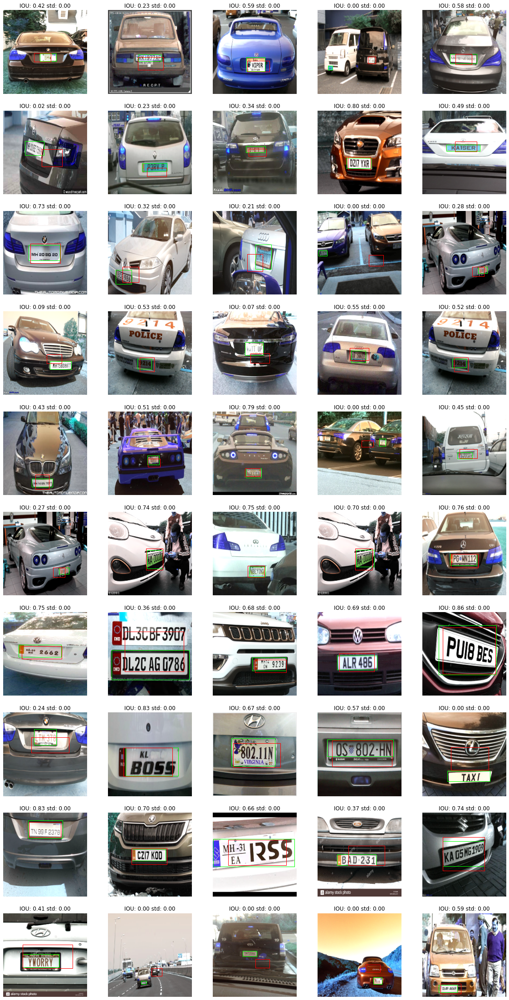

In [48]:
wandb.init(project="clustered-data-regular-cnn",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "clustered-data-regular-cnn",
           })

model_clean_train = create_model()
model_clean_train, y_pred_clean_train, map = run_experiment(model_clean_train,
                                                            X_train, y_train,
                                                            X_val, y_val,
                                                            X_test, y_test,
                                                            50, 32)

## Train on noisy data

In [49]:
# noise_factor = 10
# y_train_noise = noise_annotation(y_train * IMAGE_SIZE, noise_factor)
# y_train_noise = np.array(y_train_noise)/IMAGE_SIZE
# y_train_noise

# model_train_noise = create_model()

# model_train_noise, y_pred_train_noise, map_train_noise = run_experiment(model_train_noise,
#                                                                         X_train, y_train_noise,
#                                                                         X_val, y_val,
#                                                                         X_test, y_test, 50, 32)

## Train with probability

epoch,15
loss,1.98999
accuracy,0.82792
val_loss,1.99438
val_accuracy,0.67568
_runtime,36
_timestamp,1621045986
_step,15
best_val_loss,1.99438
best_epoch,15


epoch,▁▁▂▂▃▃▄▄▅▅▆▆▇▇██
loss,█▇▆▅▅▄▄▄▃▃▃▂▂▂▁▁
accuracy,▁▃▄▅▆▆▆▆▇▇█▇▇█▇█
val_loss,█▇▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_accuracy,▅▁▅▂█▆█▄▇▆▅▇▅▇▇▇
_runtime,▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇█
_timestamp,▁▂▂▂▃▃▄▄▅▅▆▆▆▇▇█
_step,▁▁▂▂▃▃▄▄▅▅▆▆▇▇██


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_14 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_22 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dense_23 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_24 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_flipout_30 (DenseFlipo (None, 4)                 516       
Total params: 17,951,364
Trainable params: 3,236,676
Non-trainable params: 14,714,688
_________________________________

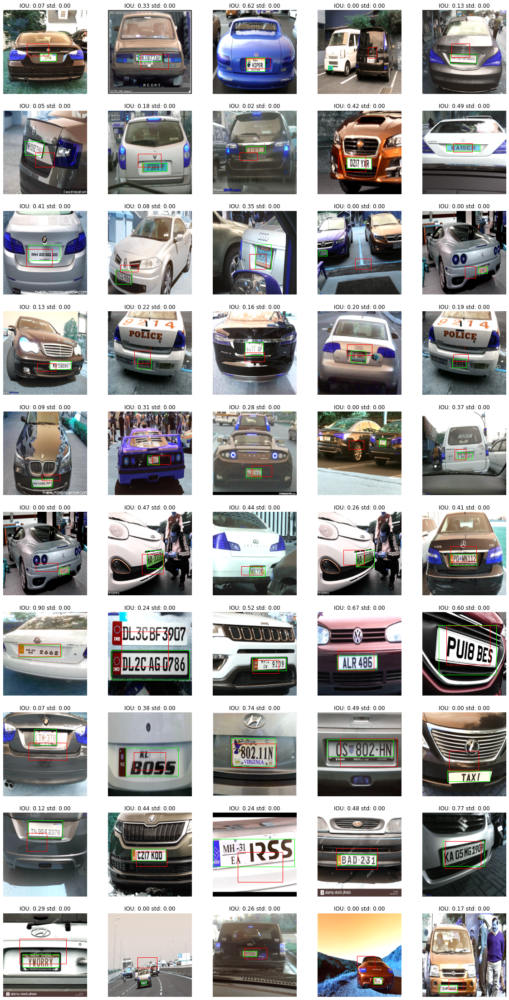

In [416]:
wandb.init(project="clustered-data-with-probability",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "clustered-data-with-probability",
           })

model_prob = create_prob_model()

model_prob, y_pred_prob, map_prob = run_experiment(model_prob,
                                                   X_train, y_train,
                                                   X_val, y_val,
                                                   X_test, y_test, 100, 32)


## Train with the full probability model

epoch,199
loss,8071.37158
accuracy,0.53896
val_loss,8029.14258
val_accuracy,0.43243
_runtime,253
_timestamp,1621043794
_step,199
best_val_loss,8029.14258
best_epoch,199


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
loss,███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
accuracy,▁▂▅▆▅▆▅▆▄▅▅█▆▆▆▇▄▇▇▅▄▆▆▆▇▄▅▅▃▅▃▃▃▃▁▂▇▄▃▂
val_loss,███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
val_accuracy,▁▄▅▅▆▅▅▅▇▇▄▇▅▆▇▇▅▃▅▅▆▇▄▄▆▅▅▅▅▅▆▄█▇▄▆▅▅▄▂
_runtime,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
_timestamp,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
_step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_10 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_flipout_23 (DenseFlipo (None, 128)               6422656   
_________________________________________________________________
dense_flipout_24 (DenseFlipo (None, 128)               32896     
_________________________________________________________________
dense_flipout_25 (DenseFlipo (None, 64)                16448     
_________________________________________________________________
dense_flipout_26 (DenseFlipo (None, 4)                 516       
Total params: 21,187,204
Trainable params: 6,472,516
Non-trainable params: 14,714,688
_________________________________

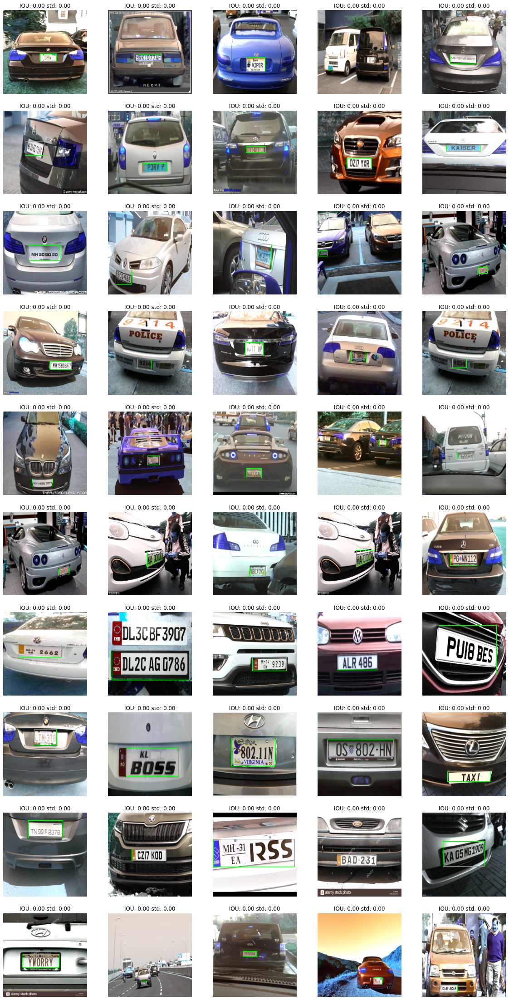

In [411]:
wandb.init(project="clustered-data-with-full_probability",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "clustered-data-with-full_probability",
           })

model_full_prob = create_full_prob_model()

model_full_prob, y_pred_full_prob, map_full_prob = run_experiment(model_full_prob,
                                                   X_train, y_train,
                                                   X_val, y_val,
                                                   X_test, y_test, 100, 32)


In [ ]:
model_full_prob, y_pred_full_prob, map_full_prob = run_experiment(model_full_prob,
                                                   X_train, y_train,
                                                   X_val, y_val,
                                                   X_test, y_test, 100, 32)


## Train with Bayesian

epoch,49
loss,21543.5332
accuracy,0.62662
val_loss,21487.0625
val_accuracy,0.51351
_runtime,69
_timestamp,1621043485
_step,49
best_val_loss,21487.0625
best_epoch,49


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
loss,████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
accuracy,▃▄▁▅▃▄▆▅▅▄█▅▇▅█▄▅▇▆▅▆▆▅▅▆▆▄▇▆▆▅▄▄▄▄▅▄▆▇▇
val_loss,████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
val_accuracy,▄▁▁▅▂▂▃▁▃▃▇▆▅▄▄▅▆▆▆▆▅█▆▅▆▃▆▄█▆▅▃▃▇▅▃▅▇▆▃
_runtime,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
_timestamp,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
_step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_9 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_flipout_19 (DenseFlipo (None, 128)               6422656   
_________________________________________________________________
dense_flipout_20 (DenseFlipo (None, 128)               32896     
_________________________________________________________________
dense_flipout_21 (DenseFlipo (None, 64)                16448     
_________________________________________________________________
dense_flipout_22 (DenseFlipo (None, 4)                 516       
Total params: 21,187,204
Trainable params: 6,472,516
Non-trainable params: 14,714,688
__________________________________

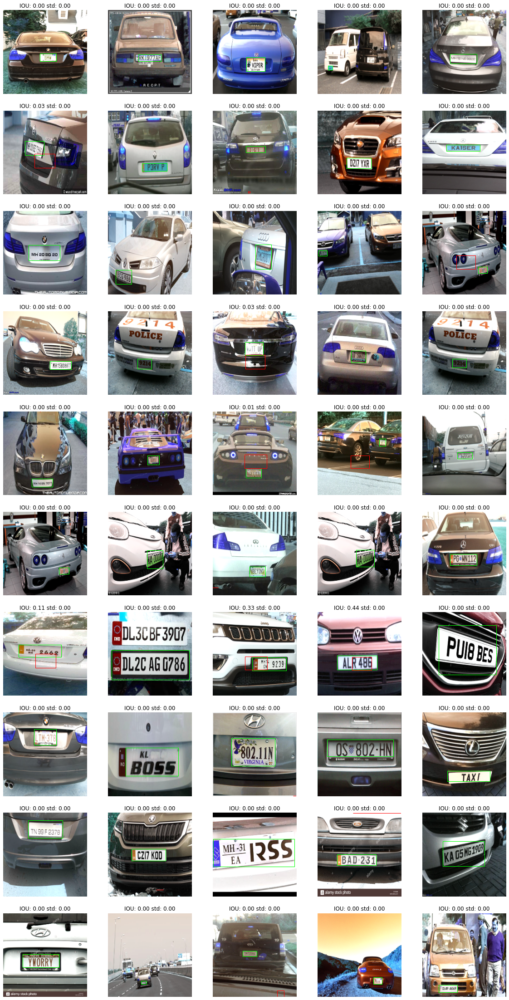

In [394]:
wandb.init(project="clustered-data-with-bayesian",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "clustered-data-with-bayesian",
           })

model_bayesian = create_full_prob_model()

model_bayesian, y_pred_bayesian, map_bayesian = run_experiment(model_bayesian,
                                                   X_train, y_train,
                                                   X_val, y_val,
                                                   X_test, y_test, 200, 32)


## Train on one cluster

wandb: ERROR Control-C detected -- Run data was not synced


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_15 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_25 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dense_26 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_27 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_flipout_31 (DenseFlipo (None, 4)                 516       
Total params: 17,951,364
Trainable params: 3,236,676
Non-trainable params: 14,714,688
_________________________________

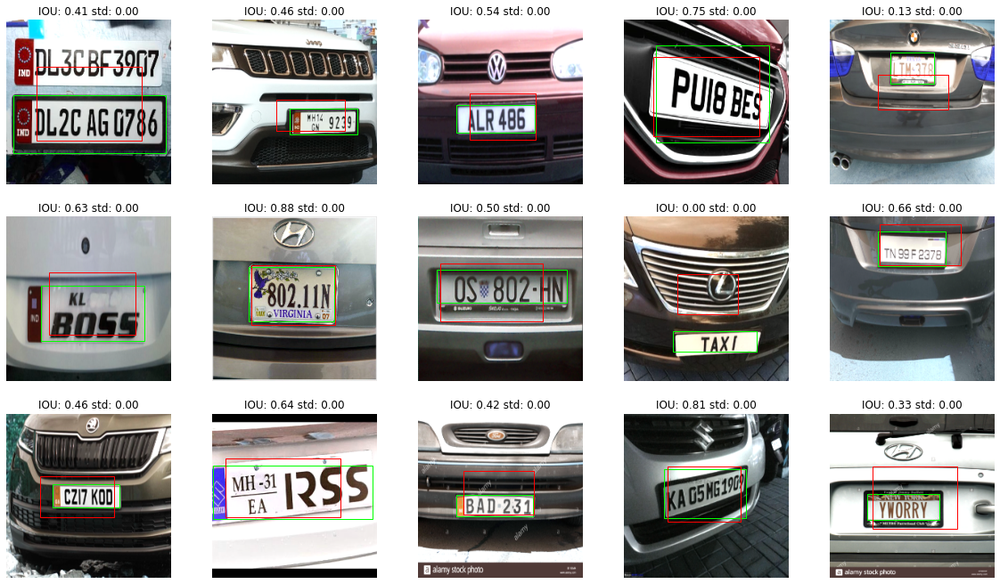

In [417]:
clst_id = 1

wandb.init(project="one-cluster-data-probability",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "one-cluster-data-probability",
           })

model_prob_one_cluster = create_prob_model()

model_prob_one_cluster, y_pred_prob_one_cluster, map_prob_one_cluster = run_experiment(model_prob_one_cluster,
                                                   X_train_d[clst_id], y_train_d[clst_id],
                                                   X_val_d[clst_id], y_val_d[clst_id],
                                                   X_test_d[clst_id], y_test_d[clst_id], 100, 32)


## Train on the whole dataset with one noisy cluster

epoch,26
loss,23850.01367
accuracy,0.6526
val_loss,23792.625
val_accuracy,0.48649
_runtime,65
_timestamp,1621046679
_step,26
best_val_loss,23792.625
best_epoch,26


epoch,▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
loss,██▇▇▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
accuracy,▂▂▁▃▃▃▃▄▄▅▄█▆▃▇▃▄▄▄▆▇▇▅▅▇▅▆
val_loss,██▇▇▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
val_accuracy,▇▄▄▃▂▃▃█▅▆▅▅▄▇▁▂█▄▃▃▄▇▅▇▅▂▂
_runtime,▁▁▁▂▂▂▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▇▇▇███
_timestamp,▁▁▁▂▂▂▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▇▇▇███
_step,▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_18 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_31 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dense_32 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_33 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_flipout_37 (DenseFlipo (None, 4)                 516       
Total params: 17,951,364
Trainable params: 3,236,676
Non-trainable params: 14,714,688
_________________________________

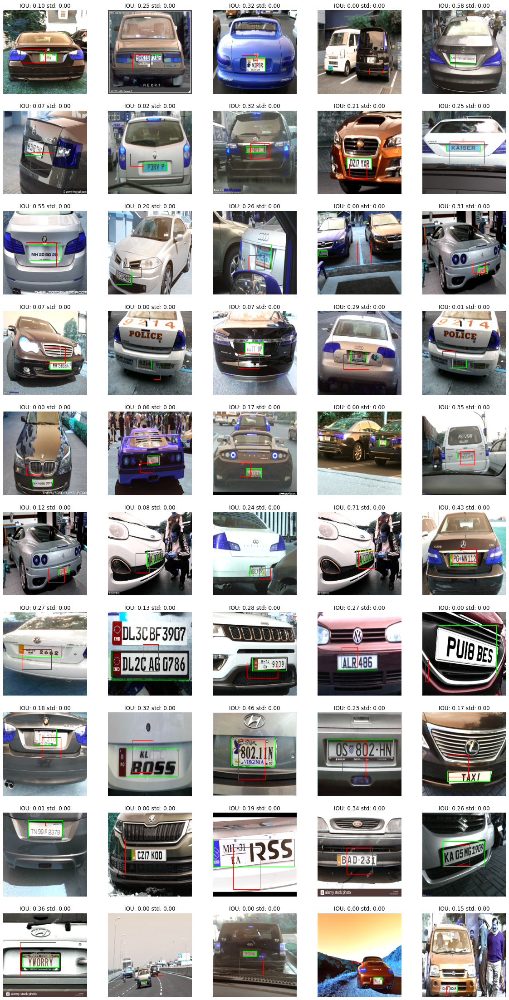

In [420]:
from copy import deepcopy

wandb.init(project="one-noisy-cluster-data-probability",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "one-noisy-cluster-data-probability",
           })



noise_clst_id = 1

# print(y_train.shape)
y_train_d_new = deepcopy(y_train_d)
y_noise = []
for yt in y_train_d_new[noise_clst_id]:
  yt = noise_annotation([y*IMAGE_SIZE], 0, IMAGE_SIZE)
  yt = np.array(yt)/IMAGE_SIZE
  y_noise.append(yt)

y_train_d_new[noise_clst_id] = np.array(y_noise)

y_train_new = merge_clusters(y_train_d_new)

model_prob_noise = create_prob_model()
model_prob_noise, y_pred_prob_noise, map_prob_noise = run_experiment(model_prob_noise,
                                                                     X_train, y_train_new,
                                                                     X_val, y_val,
                                                                     X_test, y_test, 100, 32)

wandb: ERROR Control-C detected -- Run data was not synced


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_21 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_40 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dense_41 (Dense)             (None, 128)               16512     
_________________________________________________________________
dense_42 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_flipout_40 (DenseFlipo (None, 4)                 516       
Total params: 17,951,364
Trainable params: 3,236,676
Non-trainable params: 14,714,688
_________________________________

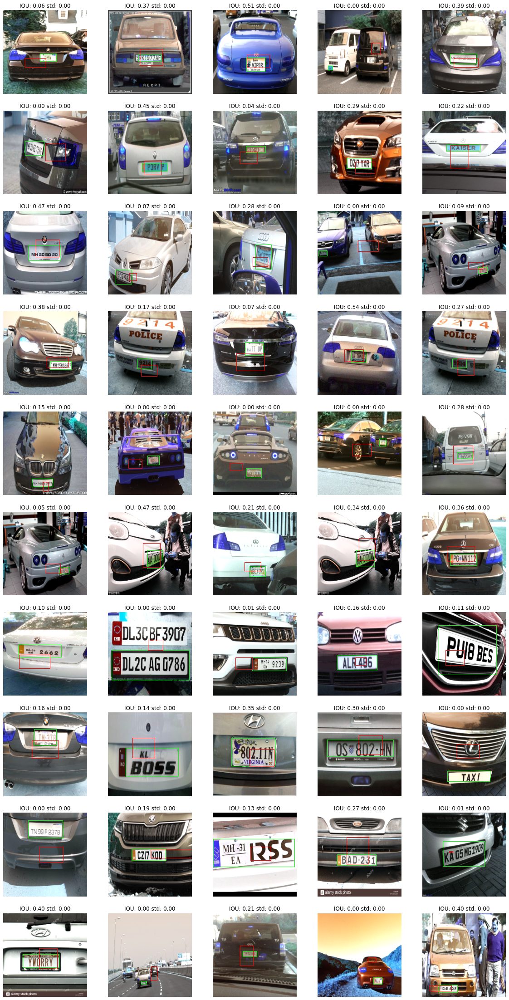

In [441]:
from copy import deepcopy

wandb.init(project="one-noisy-cluster-data-probability",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "one-noisy-cluster-data-probability",
           })



noise_clst_id = 1

# print(y_train.shape)
y_train_d_new = deepcopy(y_train_d)
y_noise = []
for yt in y_train_d_new[noise_clst_id]:
  yt = noise_annotation([y*IMAGE_SIZE], 0, IMAGE_SIZE)
  yt = np.array(yt)/IMAGE_SIZE
  y_noise.append(yt)

y_train_d_new[noise_clst_id] = np.array(y_noise)

y_train_new = merge_clusters(y_train_d_new)

model_prob_noise = create_prob_model()
model_prob_noise, y_pred_prob_noise, map_prob_noise = run_experiment(model_prob_noise,
                                                                     X_train, y_train_new,
                                                                     X_val, y_val,
                                                                     X_test, y_test, 100, 32)

## Train on an aleatoric model

epoch,49
loss,0.00058
mae,0.3033
val_loss,0.01329
val_mae,0.33477
_runtime,66
_timestamp,1621067240
_step,49
best_val_loss,0.01177
best_epoch,40


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
loss,█▇▇▇▇▇▇▇▇▇▇▇██▇▇▇███▇▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mae,▃▄▃▃▂▂▂▂▁▁▁▁▂▃▄▄▅██▇▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂
val_loss,█████████████████████▄▂▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁
val_mae,▂▄▃▃▂▂▂▂▁▁▁▁▃▅▅▄██▇▆▅▅▄▅▄▄▃▃▃▄▃▃▃▃▃▃▃▃▃▃
_runtime,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
_timestamp,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
_step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███


Model: "sequential_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_43 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_109 (Dense)            (None, 128)               3211392   
_________________________________________________________________
dense_110 (Dense)            (None, 128)               16512     
_________________________________________________________________
dense_111 (Dense)            (None, 64)                8256      
_________________________________________________________________
dense_112 (Dense)            (None, 5)                 325       
Total params: 17,951,173
Trainable params: 3,236,485
Non-trainable params: 14,714,688
_________________________________

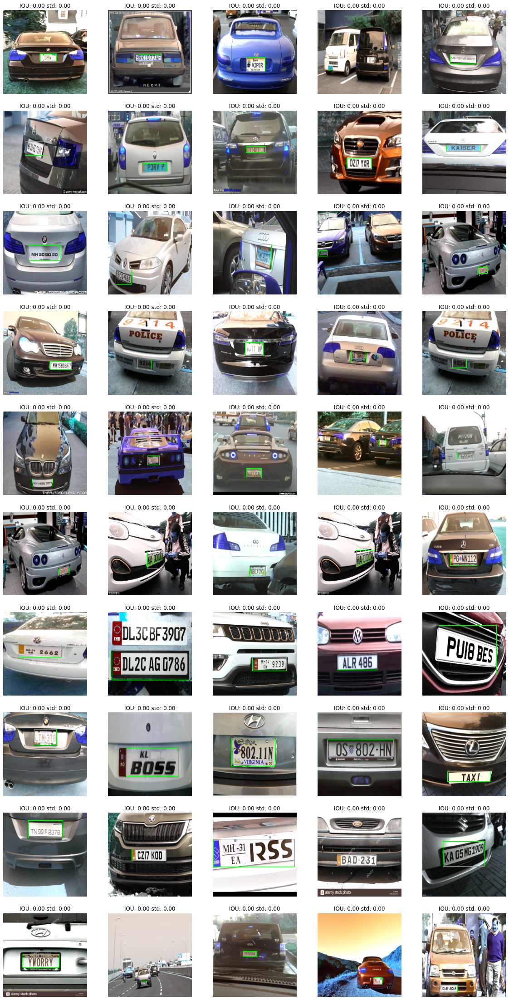

In [538]:
# reshape tensors to support two outputs
# X_train_reshaped = X_train.reshape(X_train.shape, 1)
X_train_reshaped = X_train
y_train_reshaped = np.hstack((y_train, np.zeros((y_train.shape[0], 1))))
y_val_reshaped = np.hstack((y_val, np.zeros((y_val.shape[0], 1))))
y_test_reshaped = np.hstack((y_test, np.zeros((y_test.shape[0], 1))))

wandb.init(project="clustered-data-with-aleatoric",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "clustered-data-with-aleatoric",
           })

model_alea = create_aleatoric_model()

model_alea, y_pred_alea, m_ap_alea = run_experiment(model_alea,
                                                   X_train, y_train_reshaped,
                                                   X_val, y_val_reshaped,
                                                   X_test, y_test_reshaped, 100, 32)


# Predictions

## Predict on clusters

In [581]:
def predict_on_cluster(model, X_test, y_test, iterations=10):
  test_accuracy = 0
  test_loss, test_accuracy = model.evaluate(X_test, y_test, steps=1)
  y_preds = sample_predictions(model, X_test, iterations=iterations)

  # TODO:
  # Hack to fix erroneous predictions
  # y_preds_fixed = fix_predictions(y_preds)

  plot_predictions(X_test, y_test, y_preds)

  preds_avg = average_sample_preds(y_preds)
  rectified_y_test = np.array([to_rect(y*IMAGE_SIZE) for y in y_test])
  rectified_predictions = np.array([to_rect(y*IMAGE_SIZE) for y in preds_avg])

  m_ap = calculate_map(rectified_y_test*IMAGE_SIZE, rectified_predictions*IMAGE_SIZE)
  stds = np.mean(np.std(y_preds, axis=1), axis=1)

  return y_preds, m_ap, np.mean(stds, axis=0), test_accuracy

In [422]:
def predict_on_all_clusters(model, X, y, bins):
  stats = []
  for clst_id in bins:
    # y_preds, m_ap, accuracy, mstd = predict_on_cluster(model, X[clst_ids[clst_id]], y[clst_ids[clst_id]])
    y_preds, m_ap, std, accuracy = predict_on_cluster(model, X[clst_id], y[clst_id])

    # stds = np.std(y_preds, axis=1)
    # mean_std = np.mean(stds, axis=1)
    # print(mean_std)
    # print("{}: mean std: {:0.2f}".format(cluster_id, np.mean(mean_std)))

    stats.append((m_ap['avg_prec'], std, accuracy))
    print("{} mAP: {:0.2f} std: {:0.2f} acc: {:0.2f}".format(clst_id, m_ap['avg_prec'],
                                                             std,
                                                             accuracy))
  return np.array(stats)

In [443]:
stats_prob = predict_on_all_clusters(model_prob, X_test_d, y_test_d, bins)


1/1 [==============================] - 0s 86ms/step - loss: 1.3290 - accuracy: 0.6129
0 mAP: 0.91 std: 0.04 acc: 0.61
1/1 [==============================] - 0s 51ms/step - loss: 1.3332 - accuracy: 0.6000
1 mAP: 0.91 std: 0.05 acc: 0.60
1/1 [==============================] - 0s 53ms/step - loss: 1.3294 - accuracy: 1.0000
2 mAP: 0.00 std: 0.05 acc: 1.00
1/1 [==============================] - 0s 56ms/step - loss: 1.3248 - accuracy: 0.6471
3 mAP: 0.91 std: 0.05 acc: 0.65
1/1 [==============================] - 0s 48ms/step - loss: 1.3356 - accuracy: 0.6923
4 mAP: 0.91 std: 0.06 acc: 0.69


In [ ]:
stats_prob_noise = predict_on_all_clusters(model_prob_noise, X_test_d, y_test_d, bins)

In [ ]:
stats_prob_one_cluster = predict_on_all_clusters(model_prob_one_cluster, X_test_d, y_test_d, bins)


In [423]:
def analyze_model_predictions(models, X, y, bins):
  stats = []
  for model in models:
    cluster_stats = []
    for clst_id in bins:
      # y_preds, m_ap, accuracy, mstd = predict_on_cluster(model, X[clst_ids[clst_id]], y[clst_ids[clst_id]])
      y_preds, m_ap, std, accuracy, = predict_on_cluster(model, X[clst_id], y[clst_id])

      # # stds = np.std(y_preds, axis=1)
      # # mean_std = np.mean(stds, axis=1)
      # # print(mean_std)
      # # print("{}: mean std: {:0.2f}".format(cluster_id, np.mean(mean_std)))

      print("{} mAP: {:0.2f} std: {:0.2f} acc: {:0.2f}".format(clst_id,
                                                               m_ap['avg_prec'],
                                                               std,
                                                               accuracy))
      # cluster_stats[clst_id] = (m_ap['avg_prec'], std, accuracy)
      cluster_stats.append([m_ap['avg_prec'], std, accuracy])

    # stats[name] = cluster_stats
    stats.append(cluster_stats)
  # return np.array(stats)
  return np.array(stats)

In [444]:
stats = analyze_model_predictions([model_prob, model_prob_noise, model_prob_one_cluster], X_test_d, y_test_d, bins)

1/1 [==============================] - 0s 75ms/step - loss: 1.3280 - accuracy: 0.6774
0 mAP: 0.91 std: 0.05 acc: 0.68
1/1 [==============================] - 0s 56ms/step - loss: 1.3303 - accuracy: 0.8000
1 mAP: 0.91 std: 0.05 acc: 0.80
1/1 [==============================] - 0s 49ms/step - loss: 1.3303 - accuracy: 0.9167
2 mAP: 0.00 std: 0.05 acc: 0.92
1/1 [==============================] - 0s 62ms/step - loss: 1.3252 - accuracy: 0.8235
3 mAP: 0.91 std: 0.04 acc: 0.82
1/1 [==============================] - 0s 52ms/step - loss: 1.3403 - accuracy: 0.6923
4 mAP: 0.91 std: 0.06 acc: 0.69
1/1 [==============================] - 1s 554ms/step - loss: 1.3387 - accuracy: 0.6452
0 mAP: 0.91 std: 0.04 acc: 0.65
1/1 [==============================] - 0s 65ms/step - loss: 1.3773 - accuracy: 0.3333
1 mAP: 0.00 std: 0.05 acc: 0.33
1/1 [==============================] - 0s 76ms/step - loss: 1.3408 - accuracy: 0.8333
2 mAP: 0.00 std: 0.05 acc: 0.83
1/1 [==============================] - 0s 74ms/step - l

In [ ]:
stats = analyze_model_predictions([model_prob, model_prob_noise, model_prob_one_cluster], X_test_d, y_test_d, bins)

In [566]:
t = model_alea.predict(X_test_d[0])
t[0]

array([1.0000000e+00, 4.5092372e-12, 7.0713845e-04, 2.6519394e-03,
       8.6613491e-06], dtype=float32)

In [579]:
y_test_0_reshaped = np.hstack((y_test_d[0], np.zeros((y_test_d[0].shape[0], 1))))


1/1 [==============================] - 0s 59ms/step - loss: 0.1391 - mae: 0.2878


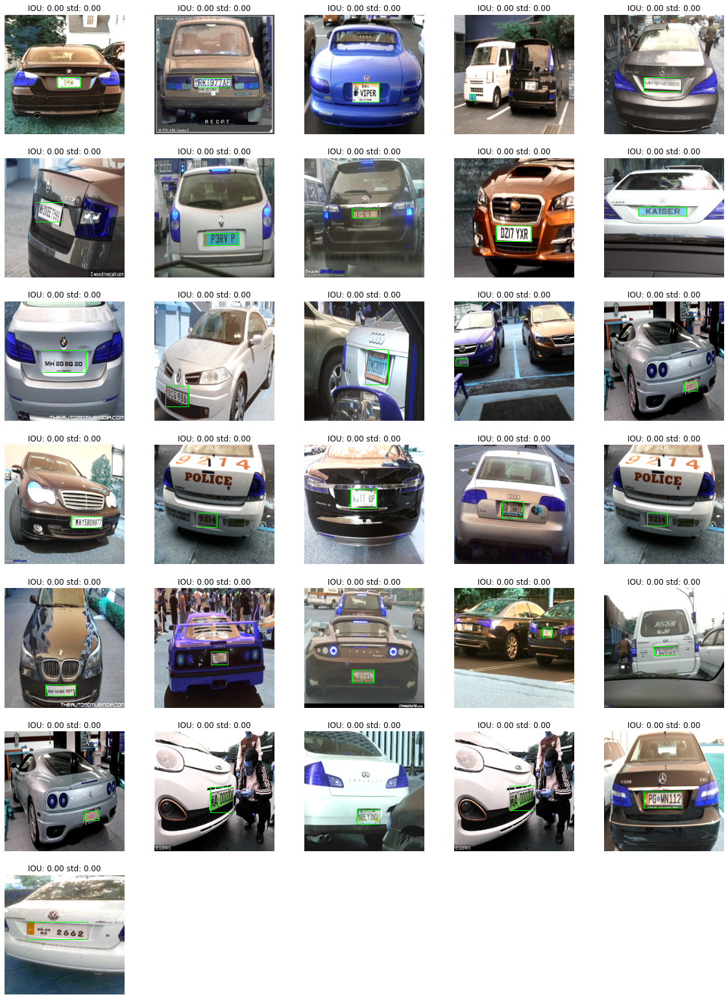

In [582]:
sta = predict_on_cluster(model_alea, X_test_d[0], y_test_0_reshaped)

In [570]:
y_preds_a_t[0].shape

(4,)

In [577]:
# average_sample_preds(y_preds_a_t)

for yp in y_preds_a_t:
  print(yp.shape)
  [np.mean(yp[:, i]) for i in range(yp.shape[1])]
  # [print(i) for i in range(yp.shape[1])]

(4,)


IndexError: ignored

In [ ]:
  mean, epistemic_std = np.mean(p[:,:,0], axis=0), np.std(p[:,:,0], axis=0)
  aleatoric_std = np.exp(0.5*np.mean(p[:,:,1], axis=0))
  ax.scatter(x_train, y_train[:,0], s=10, label='train data')
  ax.plot(x_test, x_test, ls='--', label='test data', color='green')
  ax.errorbar(x_test, mean, yerr=aleatoric_std, fmt='.', label='uncertainty', color='orange')
  ax.set_xlabel('x')
  ax.set_ylabel('y')
  ax.set_title('{} - R2 {:.2f}'.format(title, r2_score(y_test, mean)))
  ax.legend()

### Predict on all clusters

## Plot stats

In [456]:
def plot_stats(stats):
  x_bar = np.arange(K)
  fig, ax = plt.subplots()
  bar_width = .35
  # rects1 = ax.bar(x_bar - bar_width/3, stats[:, 0], label="mAP")
  rects2 = ax.bar(x_bar + bar_width/3, stats[:, 1], label="std")
  # rects3 = ax.bar(x_bar + bar_width/3, stats[:, 2], label="accuracy")

  ax.set_xticks(x_bar)
  ax.set_xticklabels(x_bar)

  # ax.bar_label(rects1, padding=3)
  # ax.bar_label(rects1, padding=3)
  # ax.bar_label(rects2, padding=3)

  ax.legend()
  fig.tight_layout()


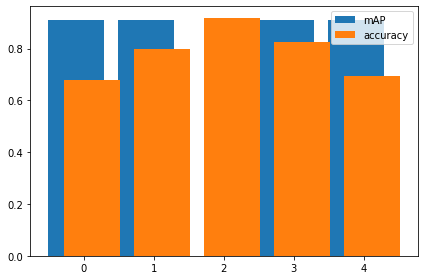

In [450]:
plot_stats(stats[0])

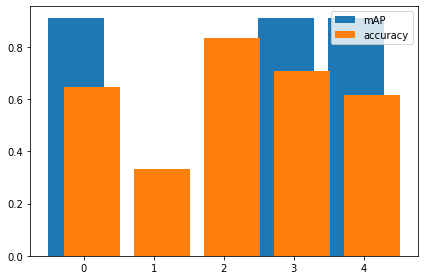

In [454]:
plot_stats(stats[1])

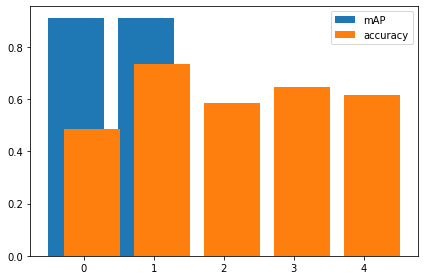

In [453]:
plot_stats(stats[2])

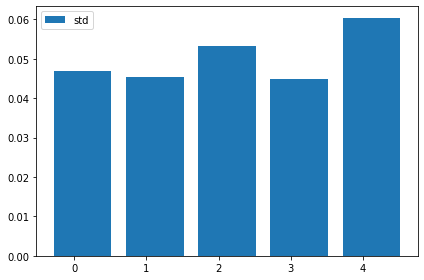

In [457]:
plot_stats(stats[0])

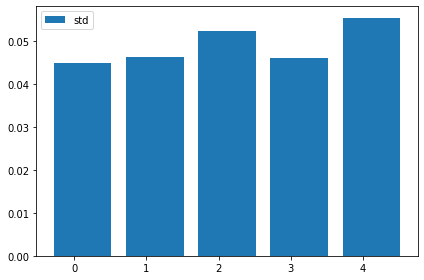

In [447]:
plot_stats(stats[1])

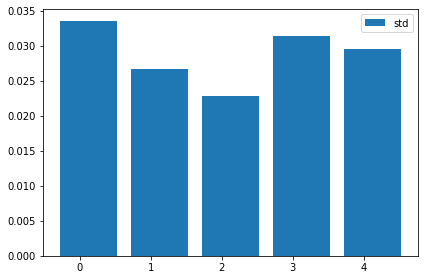

In [448]:
plot_stats(stats[2])

In [476]:
predict_on_cluster(model_prob_noise, X_test_d[3], y_test_d[3], iterations=10)

1/1 [==============================] - 0s 49ms/step - loss: 1.3305 - accuracy: 0.8235


(array([[[0.43793783, 0.56466556, 0.18975496, 0.09909848],
         [0.49667832, 0.43454337, 0.1514048 , 0.14552872],
         [0.52701914, 0.5817166 , 0.2369768 , 0.1408165 ],
         [0.5851756 , 0.48751855, 0.17024414, 0.06553393],
         [0.4895433 , 0.5083538 , 0.15272936, 0.15159968],
         [0.5188417 , 0.6142296 , 0.25268558, 0.09031421],
         [0.48539275, 0.47246763, 0.16803159, 0.11762288],
         [0.4651207 , 0.54141   , 0.13876098, 0.10563737],
         [0.45639274, 0.4660896 , 0.26798037, 0.09549815],
         [0.55681366, 0.53608   , 0.2012375 , 0.099475  ]],
 
        [[0.4826759 , 0.6261403 , 0.15405405, 0.13704358],
         [0.36103407, 0.7470449 , 0.15457708, 0.12427367],
         [0.3565078 , 0.696769  , 0.19800474, 0.1021632 ],
         [0.3958385 , 0.63168544, 0.23038487, 0.04043677],
         [0.35508856, 0.6904989 , 0.0873746 , 0.11529966],
         [0.24317941, 0.7046328 , 0.18971154, 0.06432747],
         [0.3125404 , 0.6797745 , 0.1345944 , 0.09854

In [474]:
predict_on_cluster(model_prob_one_cluster, X_test_d[3], y_test_d[3], iterations=10)

1/1 [==============================] - 0s 47ms/step - loss: 1.9583 - accuracy: 0.4118


(array([[[0.4510849 , 0.49223334, 0.30580816, 0.19178323],
         [0.39846182, 0.5069702 , 0.30076012, 0.18278158],
         [0.42389444, 0.52217764, 0.3297292 , 0.21989977],
         [0.49425113, 0.4625925 , 0.3323728 , 0.16270743],
         [0.49959216, 0.6057207 , 0.38214427, 0.19855604],
         [0.43514207, 0.4844153 , 0.32724944, 0.20156202],
         [0.44179392, 0.5466675 , 0.29177773, 0.19106075],
         [0.49060398, 0.42188781, 0.39339033, 0.17938122],
         [0.43641526, 0.57596654, 0.35914558, 0.18638201],
         [0.46206862, 0.5215558 , 0.38871935, 0.17020799]],
 
        [[0.44538233, 0.5475012 , 0.3517937 , 0.26923305],
         [0.47687712, 0.54869074, 0.29273614, 0.2399602 ],
         [0.4906886 , 0.57408994, 0.33566764, 0.22513388],
         [0.5065021 , 0.45265236, 0.39352402, 0.23892598],
         [0.47817817, 0.47830442, 0.30137086, 0.27339745],
         [0.44559768, 0.4983837 , 0.37818623, 0.20182104],
         [0.4232812 , 0.47466218, 0.30587038, 0.23594

In [483]:
st = predict_on_cluster(model_prob_one_cluster, X_test_d[2], y_test_d[2], iterations=10)

st

1/1 [==============================] - 0s 35ms/step - loss: 2.0017 - accuracy: 0.5000


(array([[[0.52108574, 0.49927756, 0.49528587, 0.38264555],
         [0.47162732, 0.5170924 , 0.4947845 , 0.36450326],
         [0.49519855, 0.51130664, 0.4923416 , 0.36904848],
         [0.5015468 , 0.512882  , 0.48580146, 0.35226583],
         [0.50853163, 0.5075335 , 0.4987298 , 0.37573695],
         [0.5093676 , 0.512475  , 0.50733966, 0.35818157],
         [0.53346556, 0.49813834, 0.47129002, 0.37006468],
         [0.4884654 , 0.49667603, 0.5097945 , 0.3975825 ],
         [0.51586473, 0.4951133 , 0.45344248, 0.3682287 ],
         [0.49663222, 0.52210766, 0.48173347, 0.35901305]],
 
        [[0.46343106, 0.49657467, 0.44784355, 0.26908162],
         [0.50568104, 0.4956318 , 0.39348385, 0.27051392],
         [0.46770683, 0.46793374, 0.4277353 , 0.29191402],
         [0.5074254 , 0.5155972 , 0.40845275, 0.30753013],
         [0.5082673 , 0.46725532, 0.39357245, 0.32249033],
         [0.45829916, 0.47861105, 0.41058975, 0.27511546],
         [0.5081189 , 0.45576376, 0.42448422, 0.25865

Need to change 3x2x4 to 2x3x4.

(iterations)x(samples)x(coordinates)

to

(samples)x(iterations)x(coordinates)


### Scratch

In [ ]:
yt = sample_predictions(model_prob, X_val, iterations=10)
yt.shape

# means = []
# # for each sample
# for y1 in yt:
means = np.mean(yt, axis=1)


np.std(np.std(yt, axis=1), axis=0)

# np.array(means).shape

# np.mean(yt[0], axis=0)


In [ ]:
np.std(yt, axis=1)

In [ ]:
from scipy.spatial import distance
distance.euclidean(yt[0][0].flatten(), means[0].flatten())

In [ ]:
yt[0][0]

# Prediction - Appendix

In [ ]:
stds = np.std(predicted, axis=1)
stds.shape
mean_stds = np.mean(stds, axis=1)

min_id = np.argmin(mean_stds)
max_id = np.argmax(mean_stds)

print("min:", min_id, mean_stds[min_id])
print("max:", max_id, mean_stds[max_id])

[print(f"{id} pred std: ", stds[id], f"mean_std:  {mean_stds[id]})") for id in range(len(X_test))]

(87, 4)

In [ ]:
def calculate_area(bbox):
  x_tl, y_tl, x_br, y_br = bbox
  return (x_br - x_tl)*(y_br - y_tl)

In [ ]:
len(sample_preds)

1000

In [ ]:
sample_preds[0]

array([[0.5533793 , 0.40564913, 0.7581168 , 0.65057504]], dtype=float32)

In [ ]:
pred_areas = [calculate_area(bbox[0]) for bbox in sample_preds]

In [ ]:
plt.hist(pred_areas, color='g', alpha=0.4, histtype='step', label='plates', fill=True, linewidth=4, density=True)


In [ ]:
def get_pred_areas(x):
  sample_preds = [model_prob_train.predict(np.expand_dims(x, [0])) for i in range(100)]
  sample_preds = fix_predictions(sample_preds[0])
  pred_areas = [calculate_area(bbox) for bbox in sample_preds]
  return pred_areas

preds0 = get_pred_areas(X_test[0])
preds1 = get_pred_areas(X_test[1])
preds2 = get_pred_areas(X_test[2])

plt.hist(preds0, color='g', alpha=0.4, histtype='step', label='0', fill=True, linewidth=4, density=True)
plt.hist(preds1, color='b', alpha=0.4, histtype='step', label='1', fill=True, linewidth=4, density=True)
plt.hist(preds2, color='r', alpha=0.4, histtype='step', label='2', fill=True, linewidth=4, density=True)

# Appendix for Clustering

## Euclidean distance of images

In [ ]:
from scipy import ndimage
i0 = ndimage.distance_transform_edt(X[0])
i1 = ndimage.distance_transform_edt(X[1])

from scipy.spatial import distance
distance.euclidean(X[0].flatten(), X[1].flatten())

## Run Elbow method to find the optimal K

In [ ]:
def find_k(X, start_k, end_k, distance_fn):
  distortions = []
  inertias = []
  mapping1 = {}
  mapping2 = {}
  K = range(start_k, end_k)
  for k in K:
      # Building and fitting the model
      kmeanModel = KMeans(n_clusters=k).fit(X)
      kmeanModel.fit(X)
  
      distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                          distance_fn), axis=1)) / X.shape[0])
      inertias.append(kmeanModel.inertia_)
  
      mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                    distance_fn), axis=1)) / X.shape[0]
      mapping2[k] = kmeanModel.inertia_
  
  return mapping1, mapping2, K, inertias, distortions

normalized_feature_maps = preprocessing.normalize(feature_maps.reshape(len(feature_maps), -1))

# 'euclidean' or 'cosine', etc
mapping1, mapping2, K, inertias, distortions = find_k(normalized_feature_maps, 2, 30, 'cosine')

# kmeans_features = KMeans(n_clusters=11, random_state=0).fit(normalized_feature_maps)

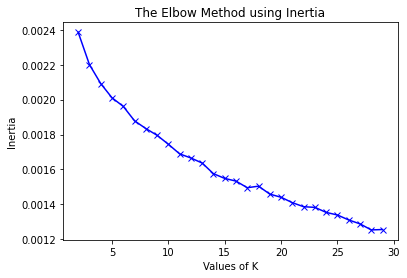

In [ ]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

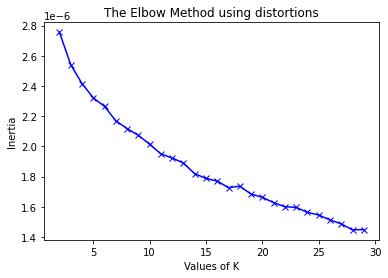

In [ ]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using distortions')
plt.show()

In [ ]:
fm_train = get_feature_maps(X_train)
fm_val = get_feature_maps(X_val)
fm_test = get_feature_maps(X_train)

## Miscellaneous

In [ ]:
nn = np.vstack([ids, kmeans.labels_])

## Elbow method to find the optimal k
Adapted from https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/

In [ ]:
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist

def find_k(X):
  distortions = []
  inertias = []
  mapping1 = {}
  mapping2 = {}
  K = range(10, 15)
  
  for k in K:
      # Building and fitting the model
      kmeanModel = KMeans(n_clusters=k).fit(X)
      kmeanModel.fit(X)
  
      distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                          'euclidean'), axis=1)) / X.shape[0])
      inertias.append(kmeanModel.inertia_)
  
      mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                    'euclidean'), axis=1)) / X.shape[0]
      mapping2[k] = kmeanModel.inertia_
  
  return mapping1, mapping2, K, inertias, distortions

In [ ]:
mapping1, mapping2, K, inertias, distortions = find_k(X.reshape(len(X),-1))


In [ ]:
print("Elbow", mapping1)
print("mapping2", mapping2)

Elbow {10: 104.03249749637331, 11: 103.10312352976362, 12: 101.6067859189693, 13: 102.26749001212667, 14: 100.82706764423298}
mapping2 {10: 4814616.603107566, 11: 4737997.623679198, 12: 4730363.9842358045, 13: 4692806.712752489, 14: 4614212.104605412}


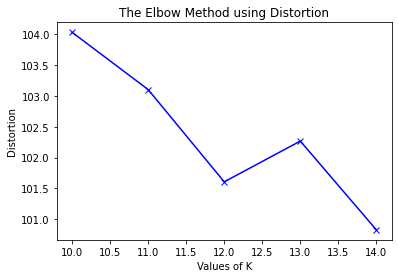

In [ ]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

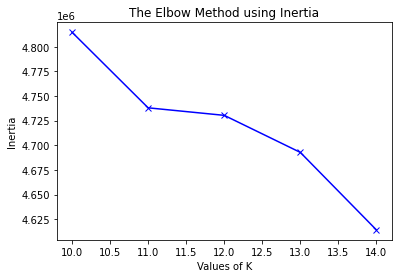

In [ ]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

In [ ]:
print("Elbow", mapping1)
print("mapping2", mapping2)

Elbow {1: 118.65955508616773, 2: 113.81741081301242, 3: 111.26931868426922, 4: 109.70504486918631, 5: 108.31961934906504, 6: 106.71785439442587, 7: 106.50219922318706, 8: 105.88184793285964, 9: 104.80005702139059}
mapping2 {1: 6303128.430595257, 2: 5779384.955971925, 3: 5502443.576369301, 4: 5340225.755338131, 5: 5208051.614096547, 6: 5058304.076693946, 7: 5027380.558469234, 8: 4969258.944017529, 9: 4874786.498505189}


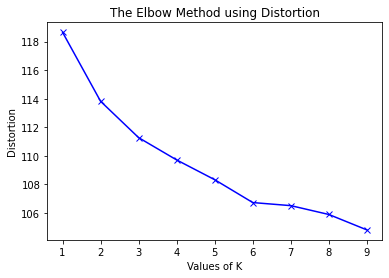

In [ ]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

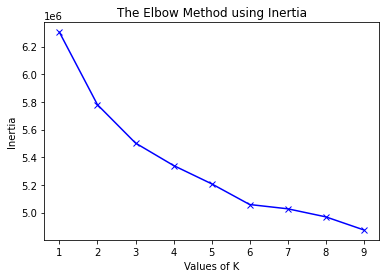

In [ ]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

## Using Cosine similarity
Adapted from:
https://stackoverflow.com/questions/63018098/deep-learning-with-python-cosine-similarity

In [ ]:
np.expand_dims(X, axis=0).shape

(1, 433, 224, 224, 3)

In [ ]:
t_test = np.expand_dims(X[0], axis=0)
t_test.shape

(1, 224, 224, 3)

In [ ]:
t1 = np.expand_dims(X[1], axis=0)

In [ ]:
t_test = np.concatenate((t_test, t1))
t_test.shape

(2, 224, 224, 3)

In [ ]:
np.expand_dims(X, axis=0).shape

(1, 433, 224, 224, 3)

input_5 (433, 7, 7, 512)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in true_divide


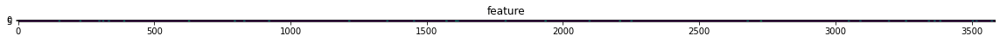

In [ ]:
feature_maps = [features]

# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model_vgg16.layers]
for layer_name, feature_map in zip(layer_names, feature_maps):
  print(layer_name, feature_map.shape)
  if len(feature_map.shape) == 4:

    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)

    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))

    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x

    # Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( 'feature' )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

## Plot group images

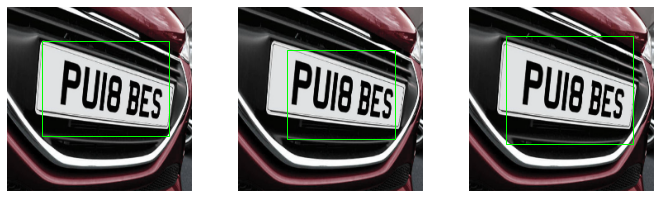

In [ ]:
plot_images(X, y, groups_features[2])

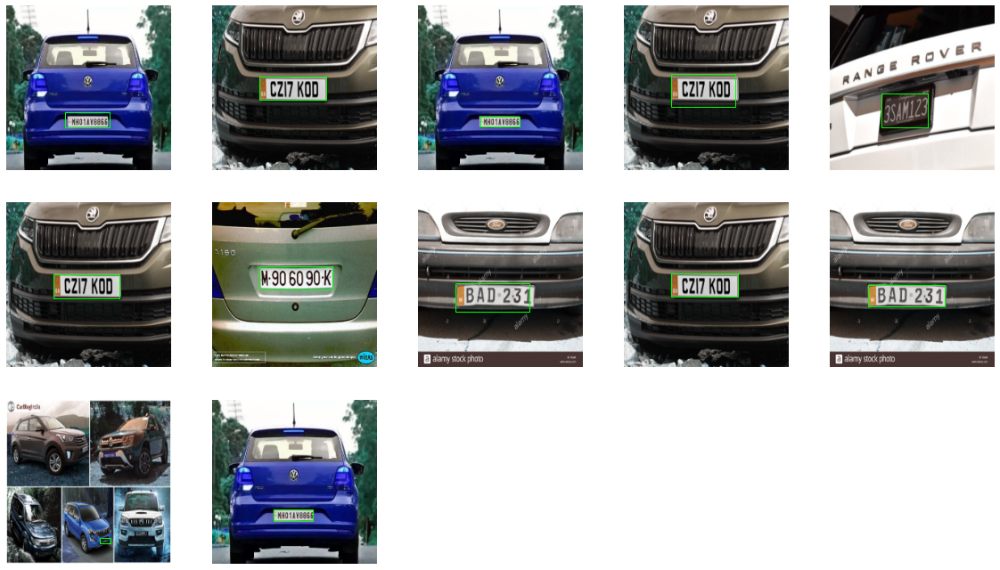

In [ ]:
plot_images(X, y, groups_features[3])

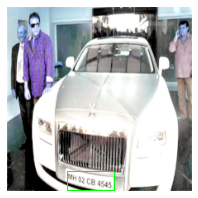

In [ ]:
plot_images(X, y, groups_features[9])

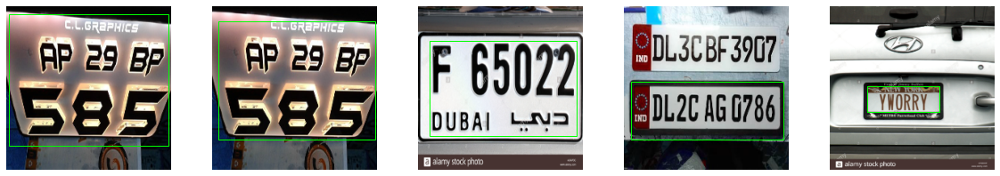

In [ ]:
plot_images(X, y, groups_features[7])

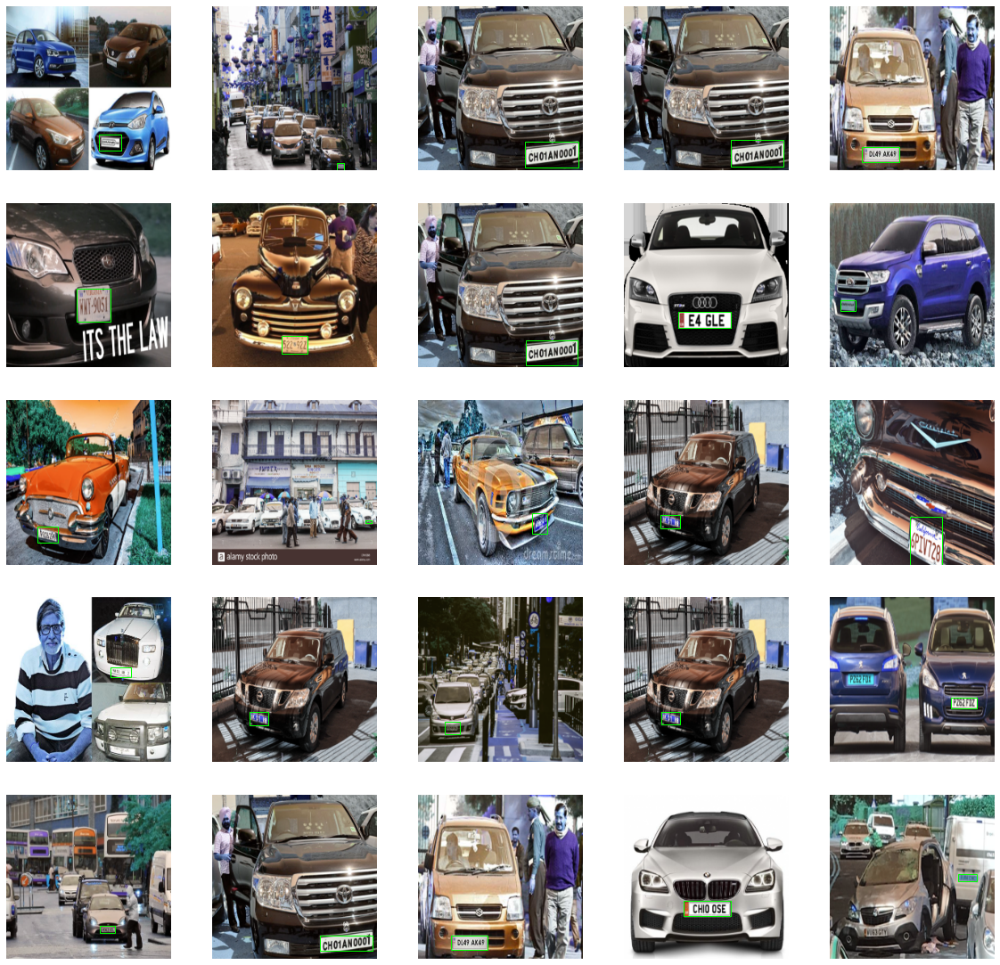

In [ ]:
plot_images(X, y, groups_features[6])

## Find cosine similarities

In [ ]:
features_compress = features.reshape(features.shape[0],
                                     features.shape[1]*features.shape[2]*features.shape[3])
similarities = cosine_similarity(features_compress)

In [ ]:
similarities[0].shape

(433,)

In [ ]:
topn = 10

In [ ]:
topn_sim = np.argsort(-similarities[topn], axis=0)[0:12]
topn_sim

array([297,  61, 368,  10, 222, 361, 118, 303, 278,  58, 264, 253])

# Bayesian
To start with, the following code is borrowed from 
https://keras.io/examples/keras_recipes/bayesian_neural_networks/ with some modifications.


## Priors and posteriors



In [ ]:
# Define the prior weight distribution as Normal of mean=0 and stddev=1.
# Note that, in this example, the we prior distribution is not trainable,
# as we fix its parameters.
def prior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    prior_model = keras.Sequential(
        [
            tfp.layers.DistributionLambda(
                lambda t: tfp.distributions.MultivariateNormalDiag(
                    loc=tf.zeros(n), scale_diag=tf.ones(n)
                )
            )
        ]
    )
    return prior_model


# Define variational posterior weight distribution as multivariate Gaussian.
# Note that the learnable parameters for this distribution are the means,
# variances, and covariances.
def posterior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    posterior_model = keras.Sequential(
        [
            tfp.layers.VariableLayer(
                tfp.layers.MultivariateNormalTriL.params_size(n), dtype=dtype
            ),
            tfp.layers.MultivariateNormalTriL(n),
        ]
    )
    return posterior_model

## Build the model

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import tensorflow_probability as tfp
tfd = tfp.distributions


# Define the prior weight distribution as Normal of mean=0 and stddev=1.
# Note that, in this example, the we prior distribution is not trainable,
# as we fix its parameters.
def prior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    prior_model = keras.Sequential(
        [
            tfp.layers.DistributionLambda(
                lambda t: tfp.distributions.MultivariateNormalDiag(
                    loc=tf.zeros(n), scale_diag=tf.ones(n)
                )
            )
        ]
    )
    return prior_model


# Define variational posterior weight distribution as multivariate Gaussian.
# Note that the learnable parameters for this distribution are the means,
# variances, and covariances.
def posterior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    posterior_model = keras.Sequential(
        [
            tfp.layers.VariableLayer(
                tfp.layers.MultivariateNormalTriL.params_size(n), dtype=dtype
            ),
            tfp.layers.MultivariateNormalTriL(n),
        ]
    )
    return posterior_model

train_size = X_test.shape[0]

# Create the model
model = Sequential()
model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
model.add(Flatten())
model.add(Dense(128, activation="relu"))
model.add(tfp.layers.DenseVariational(
    units=128,
    make_prior_fn=prior,
    make_posterior_fn=posterior,
    kl_weight=1/train_size,
    activation="relu"))
model.add(tfp.layers.DenseVariational(
    units=64,
    make_prior_fn=prior,
    make_posterior_fn=posterior,
    kl_weight=1/train_size,
    activation="relu"))
model.add(tfp.layers.DenseVariational(
    units=4,
    make_prior_fn=prior,
    make_posterior_fn=posterior,
    kl_weight=1/train_size,
    activation="sigmoid"))

model.layers[-6].trainable = False

model.summary()

Instructions for updating:
Do not pass `graph_parents`.  They will  no longer be used.
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_4 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_7 (Dense)              (None, 128)               3211392   
_________________________________________________________________
dense_variational (DenseVari (None, 128)               136347840 
_________________________________________________________________
dense_variational_1 (DenseVa (None, 64)                34093152  
_________________________________________________________________
dense_variational_2 (DenseVa (None, 4)                 34190     
Total params: 188,401,262
Trainab

In [ ]:
import datetime
import tensorflow as tf

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])

In [ ]:
model.save('my_model.h5', overwrite=True) 

In [ ]:
# Test
scores = model.evaluate(X_test, y_test, verbose=0)
print("Score : %.2f%%" % (scores[1]*100))

Score : 43.68%


In [ ]:
examples = X_test

def compute_predictions(model, iterations=100):
    predicted = []
    for _ in range(iterations):
        predicted.append(model(examples).numpy())
    predicted = np.concatenate(predicted, axis=1)

    prediction_mean = np.mean(predicted, axis=1).tolist()
    prediction_min = np.min(predicted, axis=1).tolist()
    prediction_max = np.max(predicted, axis=1).tolist()
    prediction_range = (np.max(predicted, axis=1) - np.min(predicted, axis=1)).tolist()

    for idx in range(sample):
        print(
            f"Predictions mean: {round(prediction_mean[idx], 2)}, "
            f"min: {round(prediction_min[idx], 2)}, "
            f"max: {round(prediction_max[idx], 2)}, "
            f"range: {round(prediction_range[idx], 2)} - "
            f"Actual: {targets[idx]}"
        )

compute_predictions(model)

In [ ]:
def plot_scores(train) :
    accuracy = train.history['accuracy']
    val_accuracy = train.history['val_accuracy']
    epochs = range(len(accuracy))
    plt.plot(epochs, accuracy, 'b', label='Score apprentissage')
    plt.plot(epochs, val_accuracy, 'r', label='Score validation')
    plt.title('Scores')
    plt.legend()
    plt.show()

In [ ]:
%load_ext tensorboard

%tensorboard --logdir logs/fit

# Reference
- [TensorFlow Probability regression tutorial](https://colab.research.google.com/github/tensorflow/probability/blob/master/tensorflow_probability/examples/jupyter_notebooks/Probabilistic_Layers_Regression.ipynb)